In [1]:
import scipy as sc
from scipy import signal
import os   #used for directory work
import matplotlib.pyplot as plt #used for creating plots
import pandas as pd
import numpy as np
import matplotlib.patches as mpatches #used for plot legends
%matplotlib inline

#import matplotlib as mpl
#from matplotlib.lines import Line2D


burn_d = {'01': [21000 ,22289], '02': [14000, 14972], '03': [20000, 20296], '04': [30000, 34979], '05': [15000, 15974], \
          '06': [6000, 6544], '07': [25000, 27822], '08': [18000, 19810], '09': [20000, 25047], '11': [30000,30681],  \
          '12': [60000, 62937], '13': [50000, 55131], '18': [185000, 192322], '19': [45000, 48831], '20': [24000, 25860],\
          '21': [25000, 27822], '22': [27000, 29484], '23': [45000, 48846], '24': [20000, 23015], '25': [25000, 26797], \
          '26': [25000, 26909], '27': [35000, 36916], '28': [27000, 28673], '29': [25000, 28166], '30': [12000, 13954], \
          '31': [30000, 31046], '32': [25000, 26294], '33': [20000, 23293], '34': [40000,43702]}

In [2]:

def text_finder(path):
    txt_files=[]
    all_files = os.listdir(path) #tells what directory the files are in
    for i in all_files: #reading only the .txt files 
        if i[-4:] == ".txt":
            txt_files.append(i)
    txt_files.sort() #alphabetizes them
    
    return txt_files

def file_to_df(path):
    df= pd.read_csv(path,na_values = ['NAN', "00nan", "NaN"], sep=" ")
    #df.fillna(value=np.nan, inplace=True)
    
    return df

def day_color(df, full_timestamp = True):
    dates = ["2018-03-05", "2018-03-06", "2018-03-17", "2018-05-09", "2018-05-10", \
            "2018-05-11", "2018-09-22", "2019-05-20", "2019-05-21", "2019-05-22", \
            "2019-05-29", "2019-05-31"]
    colors = ["navy", "maroon", "darkolivegreen", "darkorange", "plum", "turquoise", \
              "saddlebrown", "y", "goldenrod", "mediumseagreen", "indigo", "magenta"  ]
    
    
    if full_timestamp == True:
        for t in range(len(dates)):
            if df["TIMESTAMP"][0][:10] ==dates[t]:
                return colors[t]
                break
                l
    if full_timestamp == False:
        for t in range(len(dates)):
            if str(pd.Timestamp(df["YYYY"][0],df["MM"][0],df["DD"][0]))[:10] == dates[t]:
                return colors[t]
                break
                
def fire_start(df,n):    
    ### Finding the start of fire
    x_fire, fire_5sig = 9e10, np.nanmean(df["T"][:n])+5*np.std(df["T"][:n]) 
    start = n-9000
    if n-9000< 0:
        start = 0
    #print(5*np.std(df["T"][start:n]))
    for i in range(n, len(df["T"])):
        if df["T"][i] > fire_5sig:
            x_fire = i
            break
    
    return x_fire


In [3]:
#######################################################
def speed_calculation(df):
    horizontal_speed = np.sqrt(df["V"]**2 + df["U"]**2)
    return horizontal_speed

#######################################################

#######################################################
def welch_spectra(var_lst, freq = 10):
    
    nan_count = 0 
    
    df = pd.DataFrame()
    
    df["var"] = var_lst
    nan_count = int(len(df) - df.count())
    #print(nan_count)
    df = df.interpolate(method='linear', axis=0)
    df.fillna(value=0, inplace=True)
    
    #var_lst = list(df["var"])
    #for i in range(len(var_lst)):
    #    if str(var_lst[i]).lower() =="nan": 

     #       var_lst[i] = 0 
     #       nan_count+= 1
    #count_nan = len(df) - df.count()
    welch_lst, x_lst = signal.welch(list(df["var"]), freq)#, nperseg = 28) #,nperseg=8000, average='median')
    
    return  welch_lst, x_lst, nan_count

#def calculations():

In [4]:
def welch_power_spec(burn,variable, sigma_fire = True ):

    burn_d = {'01': [21000 ,22289], '02': [14000, 14972], '03': [20000, 20296], '04': [30000, 34979], '05': [15000, 15974], \
              '06': [6000, 6544], '07': [25000, 27822], '08': [18000, 19810], '09': [20000, 25047], '11': [30000,30681],  \
              '12': [60000, 62937], '13': [50000, 55131], '18': [185000, 192322], '19': [45000, 48831], '20': [24000, 25860],\
              '21': [25000, 27822], '22': [27000, 29484], '23': [45000, 48846], '24': [20000, 23015], '25': [25000, 26797], \
              '26': [25000, 26909], '27': [35000, 36916], '28': [27000, 28673], '29': [25000, 28166], '30': [12000, 13954], \
              '31': [30000, 31046], '32': [25000, 26294], '33': [20000, 23293], '34': [40000,43702]}

    path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Full-Timestamp/Burn-" #w10
    path_end = "/sonics/"
    p = path+burn+ path_end
    files = text_finder(p)

    blu_patch = mpatches.Patch(color = "b", label = "PRE", linewidth = .1)
    red_patch = mpatches.Patch(color = "r", label = "BRN", linewidth = .1)
    grn_patch = mpatches.Patch(color = "g", label = "PST", linewidth = .1)
    patches = [blu_patch, red_patch, grn_patch]

    fig, axs = plt.subplots(nrows=4,ncols=4,figsize=(18,12), sharey = True, sharex = True)

    file_count=0
    for col in range(4):
        for row in range(4):
            df=file_to_df(p+files[file_count])
            temp_5sig = " "
            ax = axs[ col, row]
            if sigma_fire == True:
                if variable !="S":
                    pre_lst, brn_lst, pst_lst = fire_period_split(list(df[variable]), burn_d[burn][1])
                if variable == "S":
                    pre_lst, brn_lst, pst_lst = fire_period_split(speed_calculation(df), burn_d[burn][1])
            if sigma_fire == False:
                
                x_fire = fire_start(df, burn_d[burn][0])
                if x_fire == 9e10:
                    x_fire = burn_d[burn][1]
                    temp_5sig = "*"
                if variable !="S":
                    pre_lst, brn_lst, pst_lst = fire_period_split(list(df[variable]), x_fire)
                if variable == "S":
                    pre_lst, brn_lst, pst_lst = fire_period_split(speed_calculation(df), x_fire)
            
            pre_x, pre_y, pre_nan = welch_spectra(pre_lst)
            brn_x, brn_y, brn_nan = welch_spectra(brn_lst)
            pst_x, pst_y, pst_nan = welch_spectra(pst_lst)

            ax.loglog(pre_x, pre_y, color = "b", linewidth=1)
            ax.loglog(brn_x, brn_y, color = "r", linewidth=1)
            ax.loglog(pst_x, pst_y, color = "g", linewidth=1)
            
            if variable == "T":
                ax.set_xlim(3*10**(-2),.55*10**1)
            if variable == "W":
                ax.set_ylim(10**(-4),10**(0))
            if varible == "S":
                ax.set_ylim(10**(1),10**(0))
                
            ax.set_title(files[file_count][:2]+temp_5sig, fontsize = 14)
            
            
            fmt = "{:4}:{:3}/{} "
            if pre_nan > 0 or len(pre_lst) < 9000:
                ax.text(1.5,5*.1, fmt.format("PRE", pre_nan, len(pre_lst)))
           
            if brn_nan > 0 or len(brn_lst) < 9000:
                ax.text(1.5,2*.1, fmt.format("BRN", brn_nan, len(brn_lst)))
            
            if pst_nan > 0 or len(pst_lst) < 9000:
                ax.text(1.5,.8*.1, fmt.format("PST", pst_nan, len(pst_lst)))
            
            
            ax.grid()
            #ax.legend(markerscale = 5, loc = "upper right")
            file_count+=1
            if row == 0:
                ax.set_ylabel("Power", fontsize = 14)
            if col == 3:
                ax.set_xlabel("Frequency", fontsize = 14)
                
    fig.tight_layout()
    leg = fig.legend(handles = patches, ncol = 3, bbox_to_anchor = (.8, .97), fontsize = 16)
    fig.subplots_adjust(hspace=0.2, wspace=0.1, top=.9)#, left = 0.05, right = .95, bottom = .07)
    if variable == "S":
        title = "Horizontal Winds ("+variable+"')"
    if variable == "T":
        title = "Temperature("+variable+"')"
    if variable == "W":
        title = "Verticle Winds ("+variable+"')"
         
    fig.suptitle("Power Spectral Density of " + title+" Burn "+burn, fontsize = 20, x= .3, y= .96, fontweight = "heavy")                 
    if sigma_fire == True:
        fig.text(.825,.94, r"5$\sigma$: First Sonic", fontsize =18)
        fig.savefig("PDS-"+variable+"_first_sonic_Burn-"+burn+".png",dpi=350)
    if sigma_fire == False:
        fig.text(.825,.94, r"5$\sigma$: Per Sonic", fontsize =18)
        fig.savefig("PDS-"+variable+"_per_sonic_Burn-"+burn+".png",dpi=350)
    plt.show()

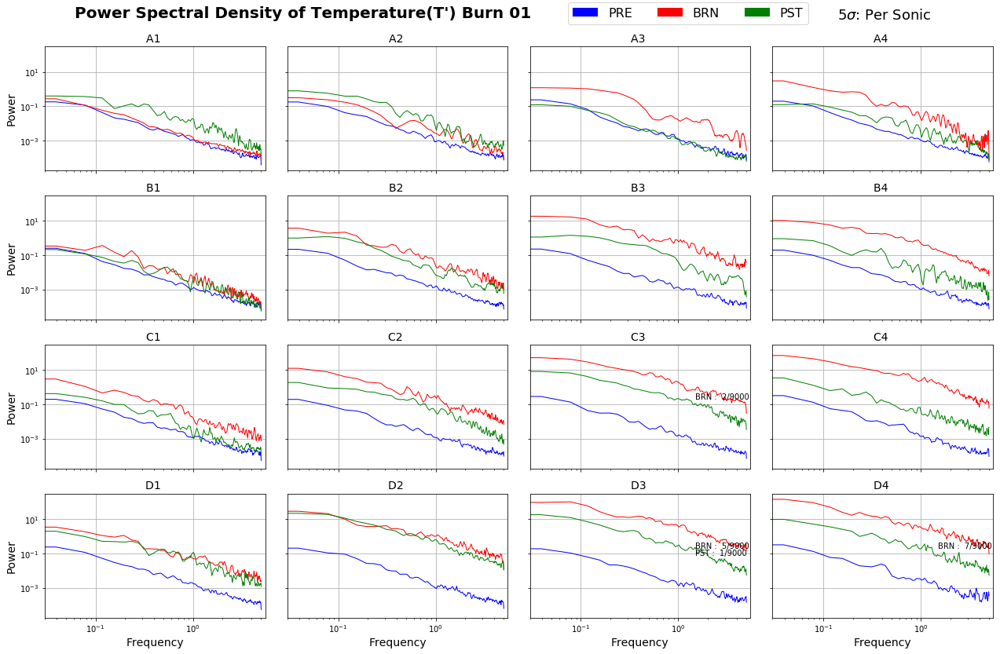

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 29, using nperseg = 29
  .format(nperseg, input_length))


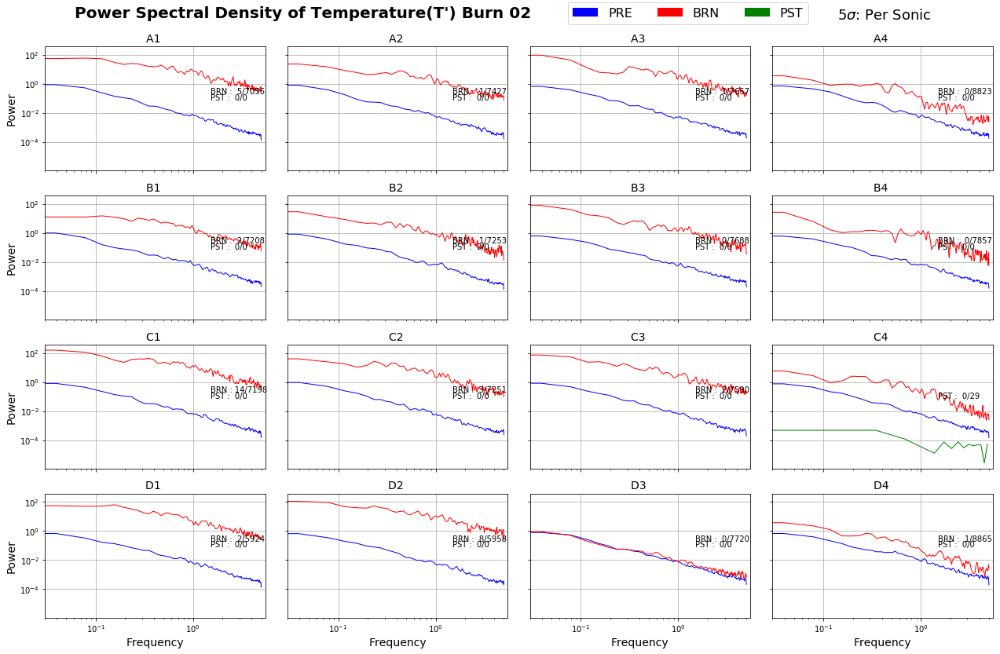

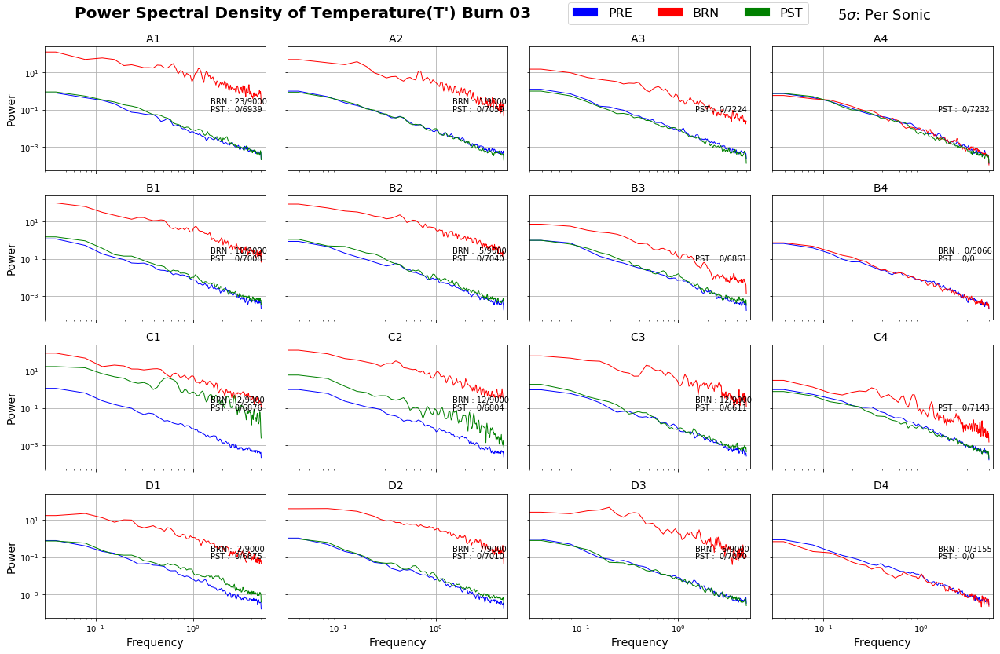

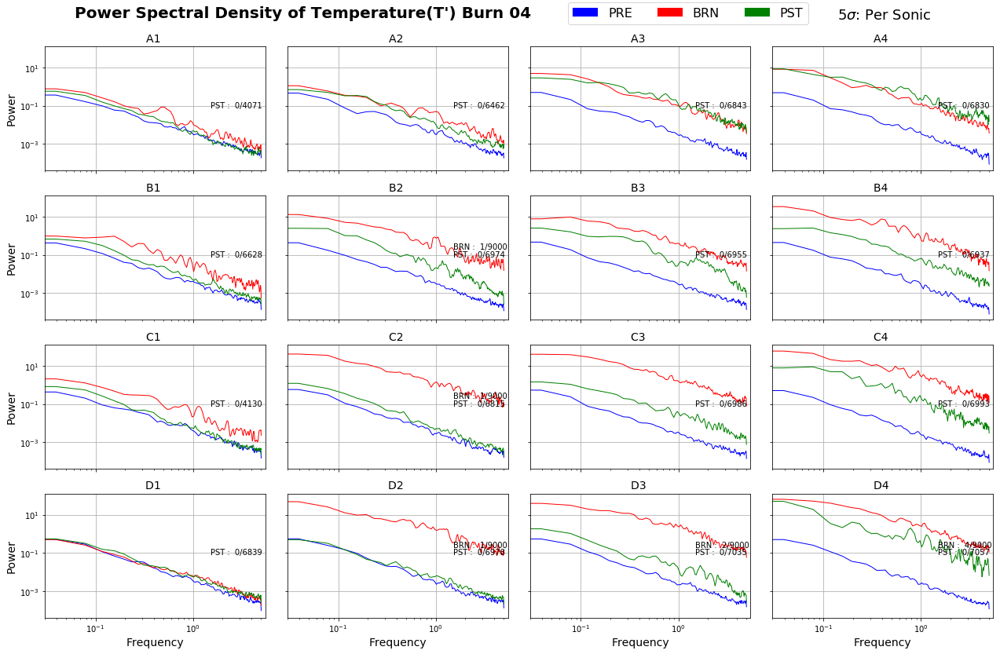

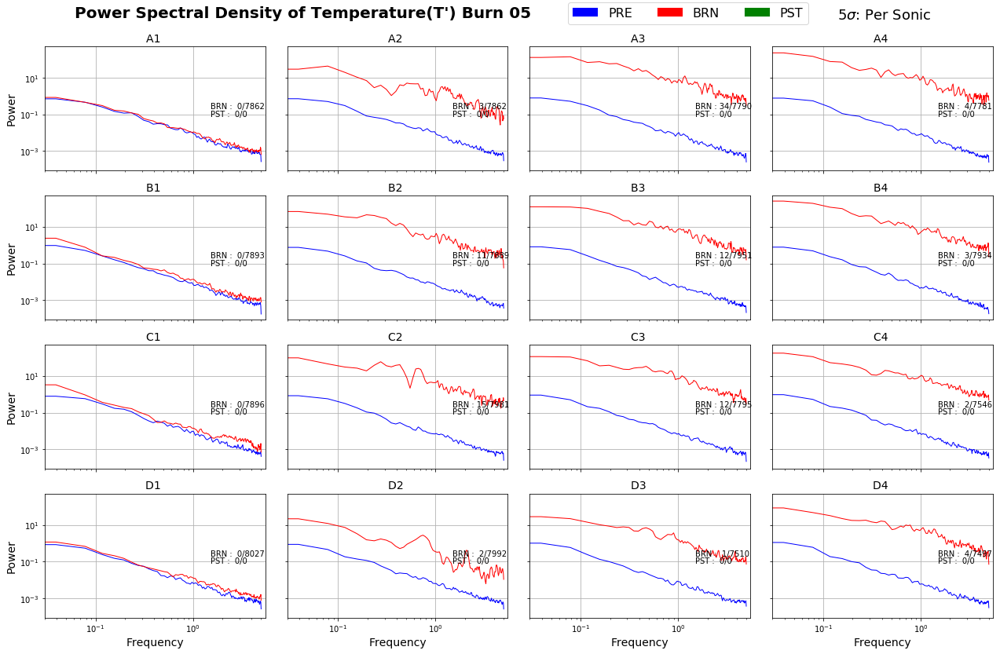

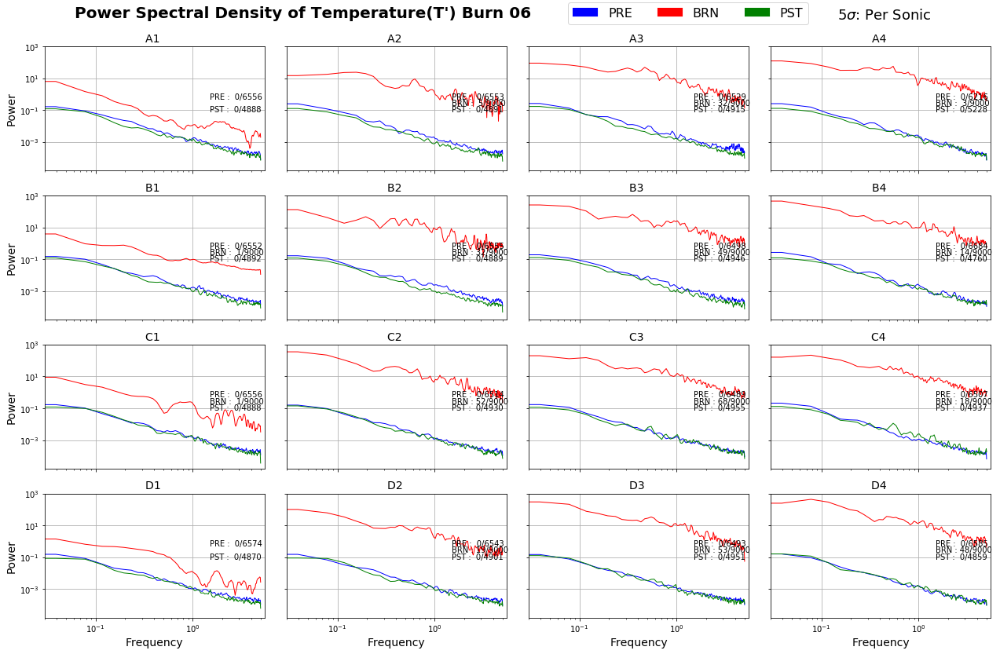

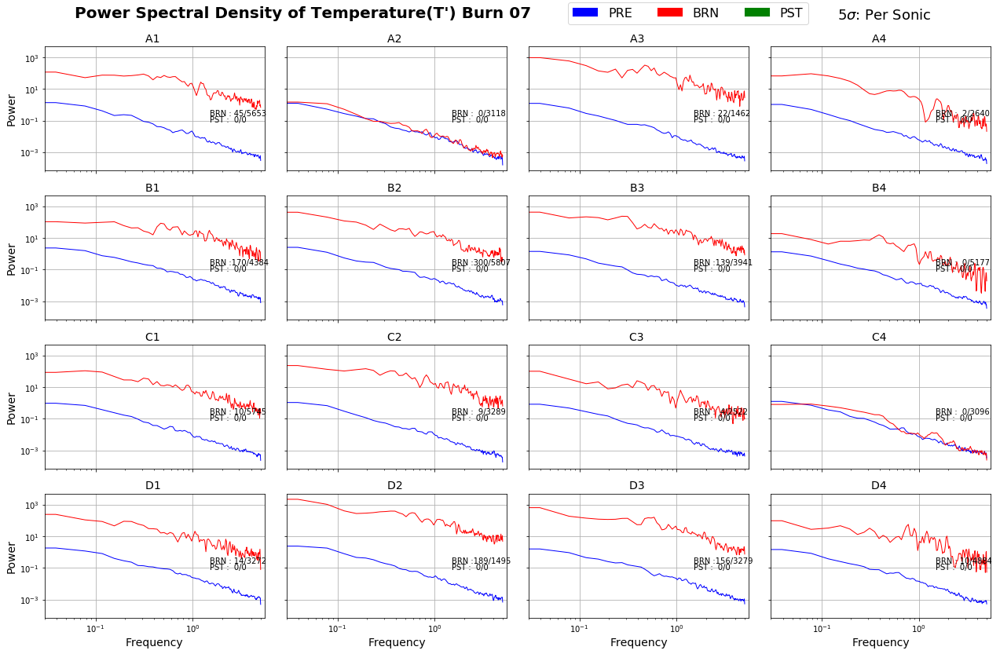

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


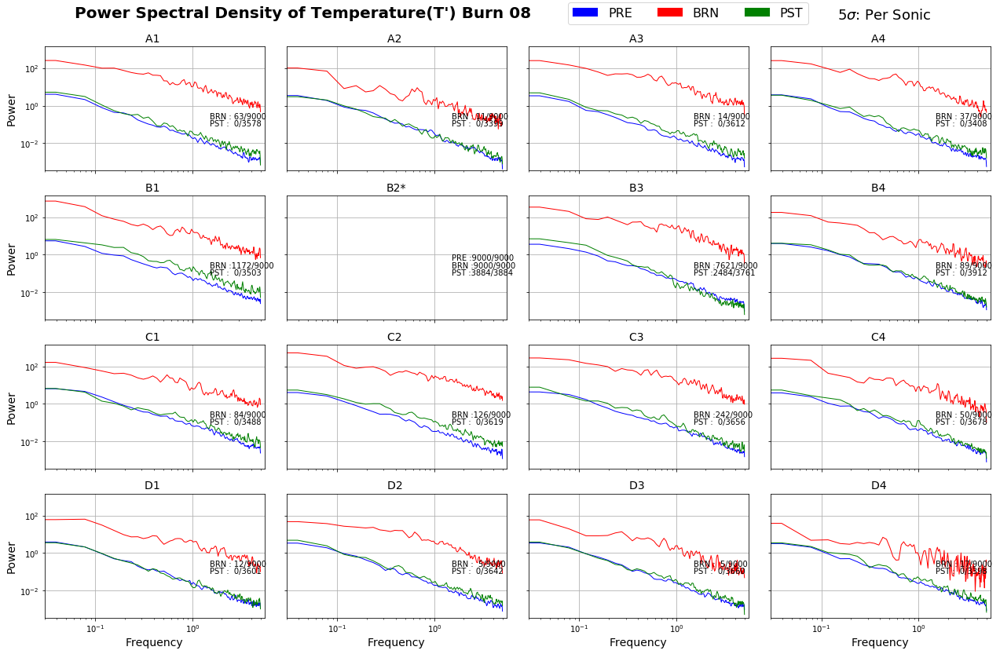

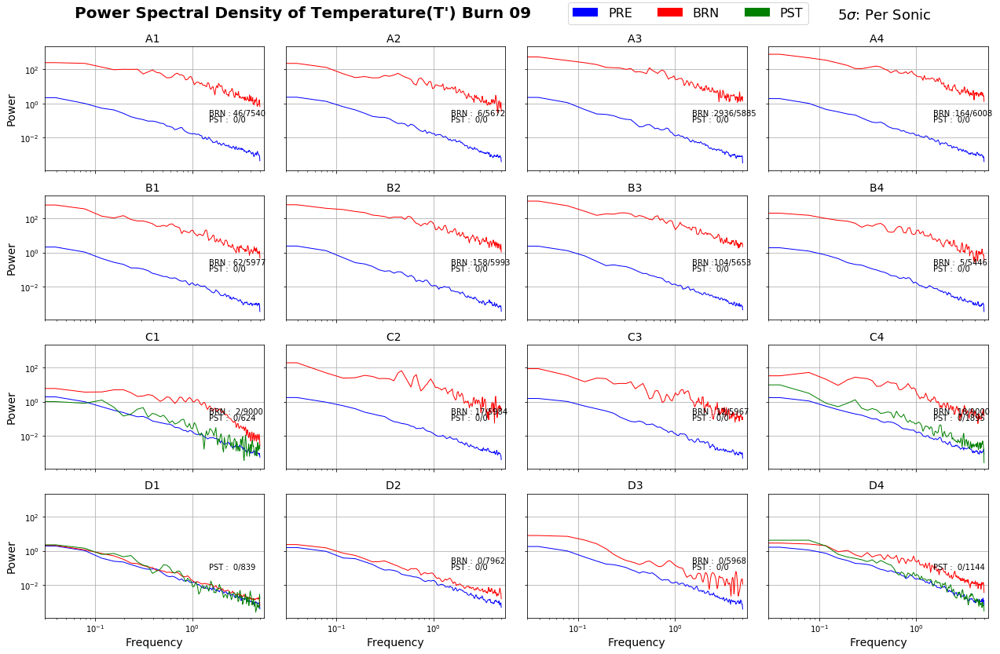

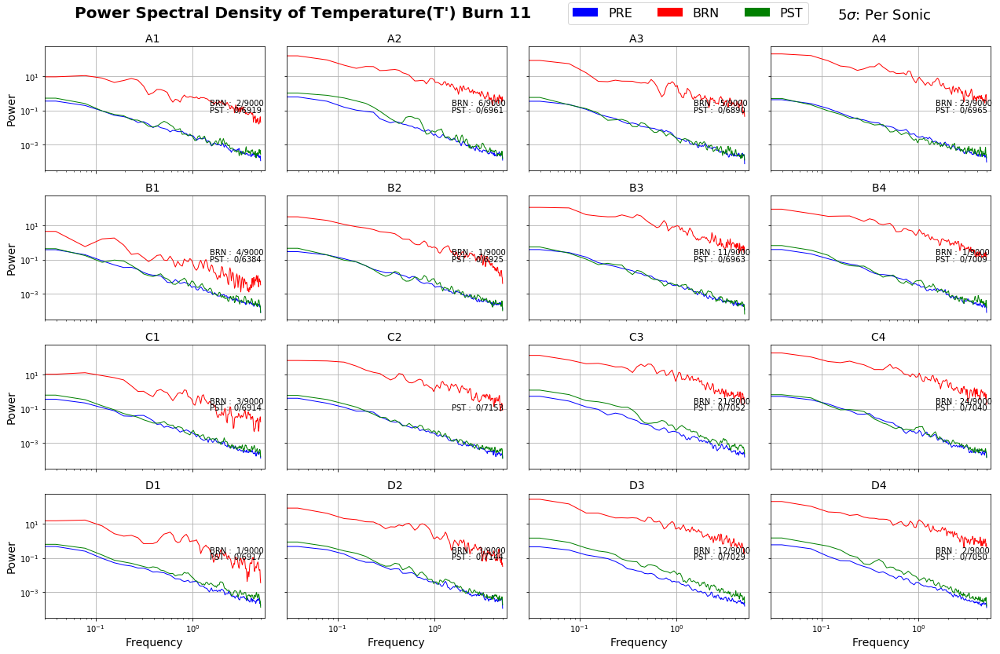

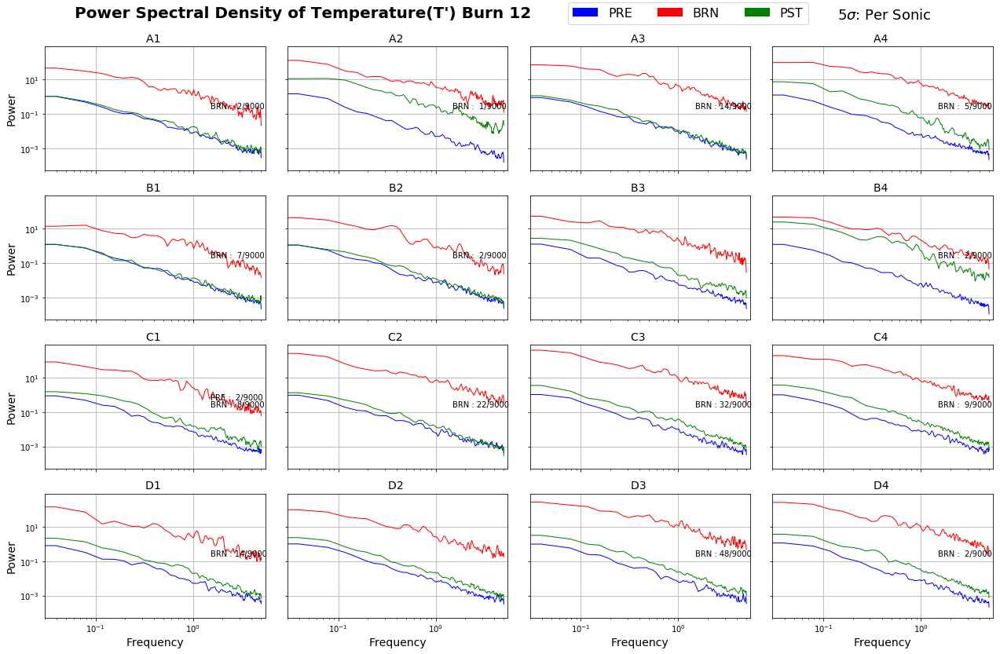

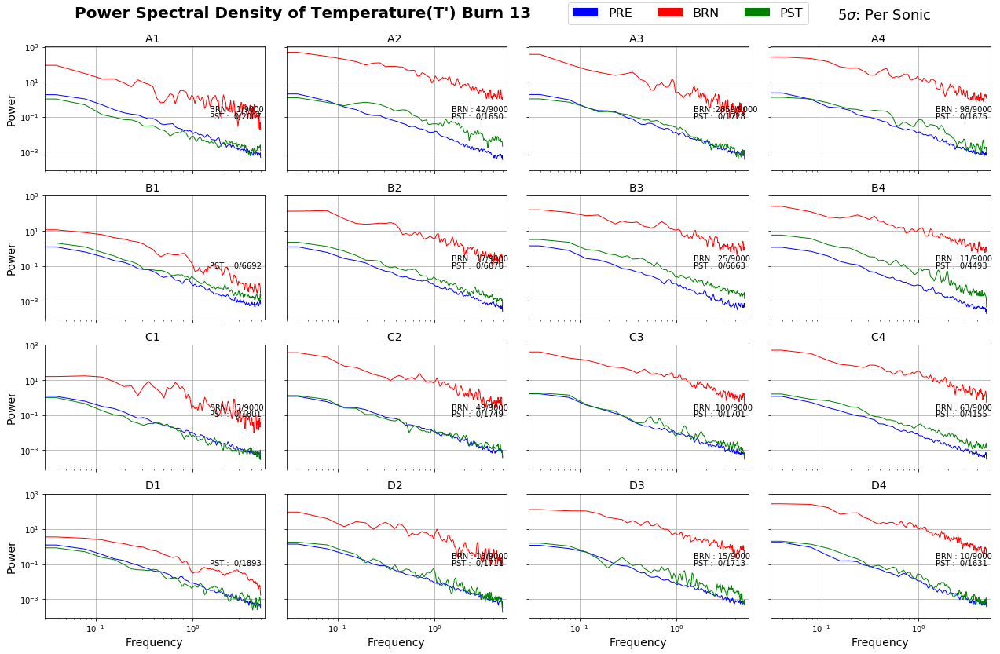

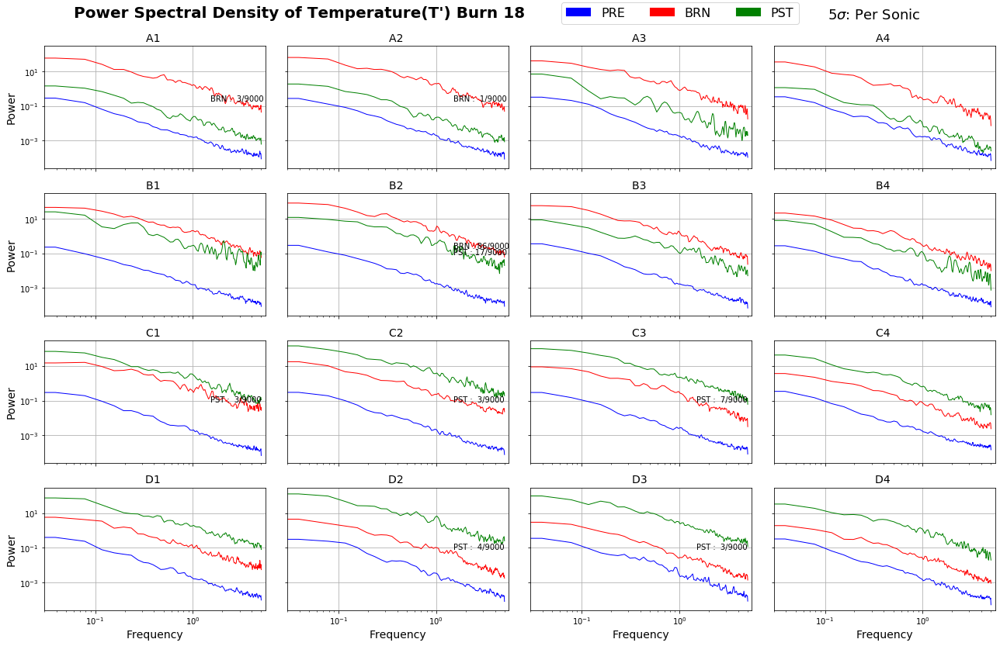

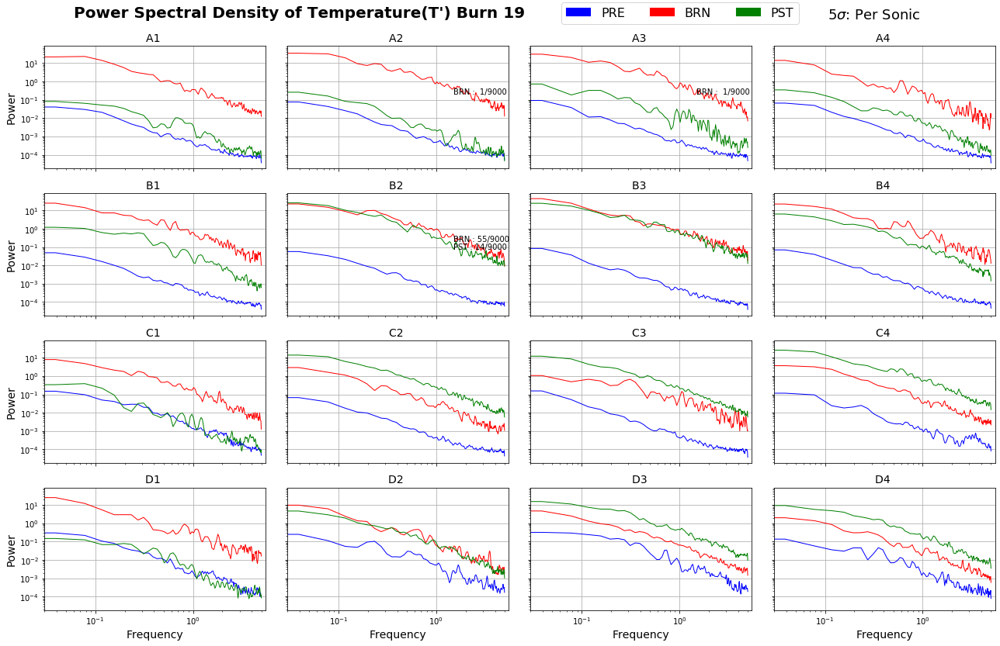

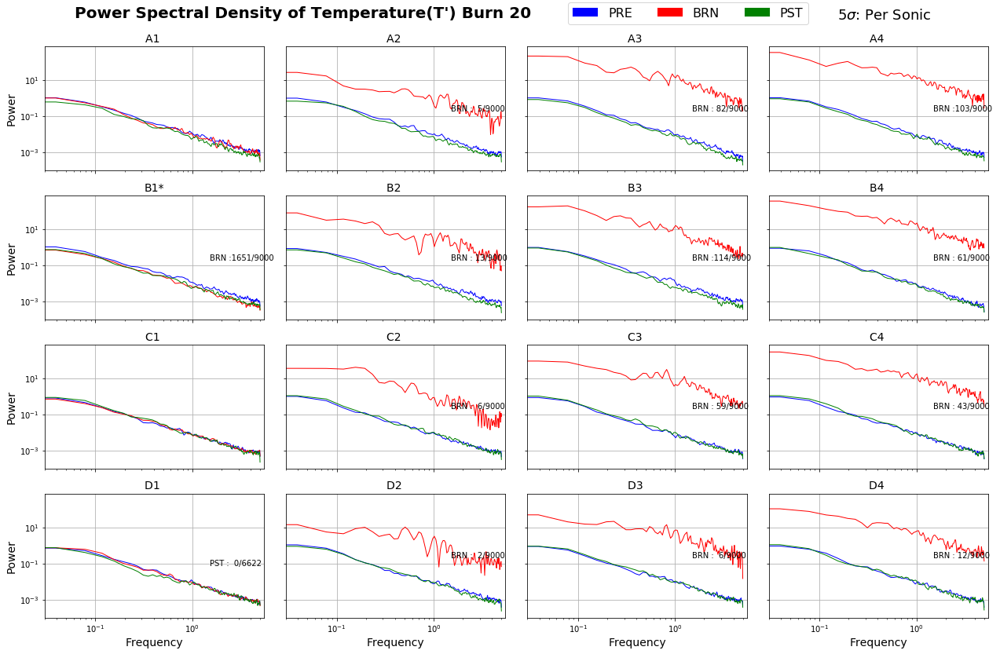

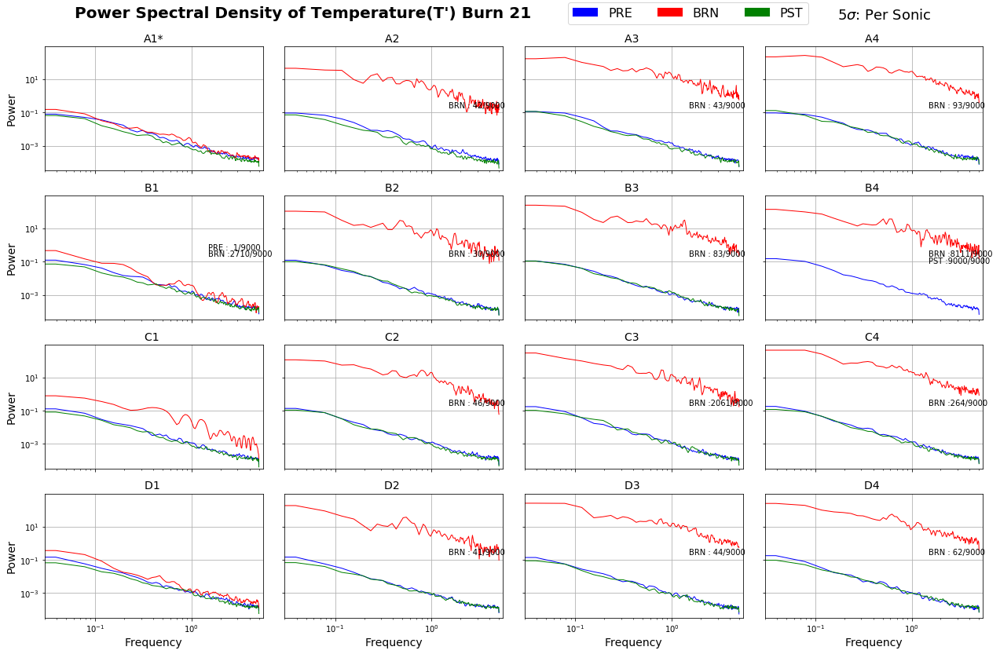

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 246, using nperseg = 246
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 244, using nperseg = 244
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 234, using nperseg = 234
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 217, using nperseg = 217
  .format(nperseg, input_length))


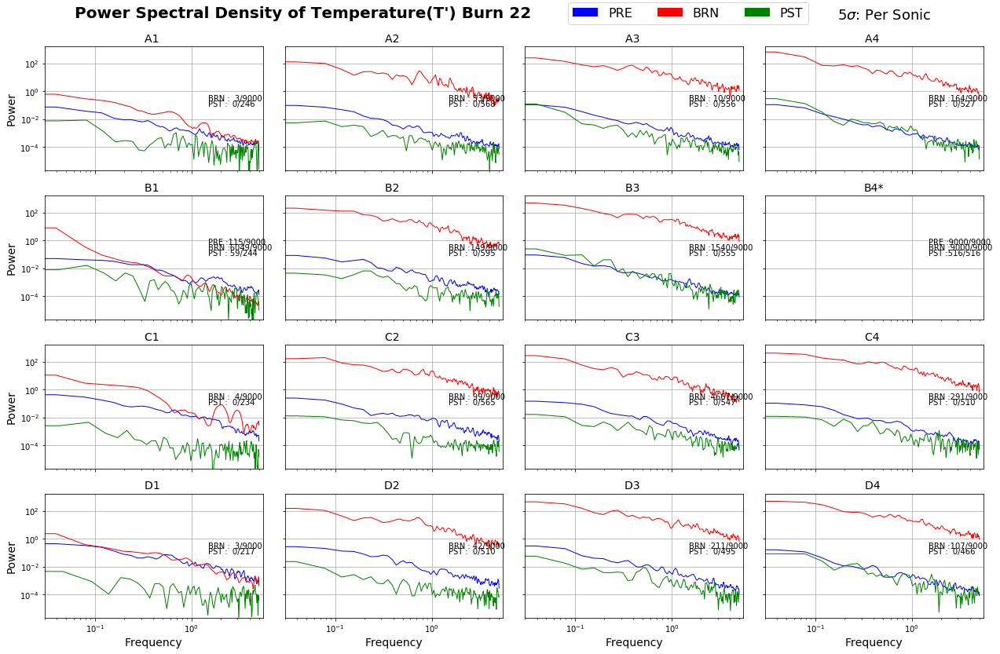

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


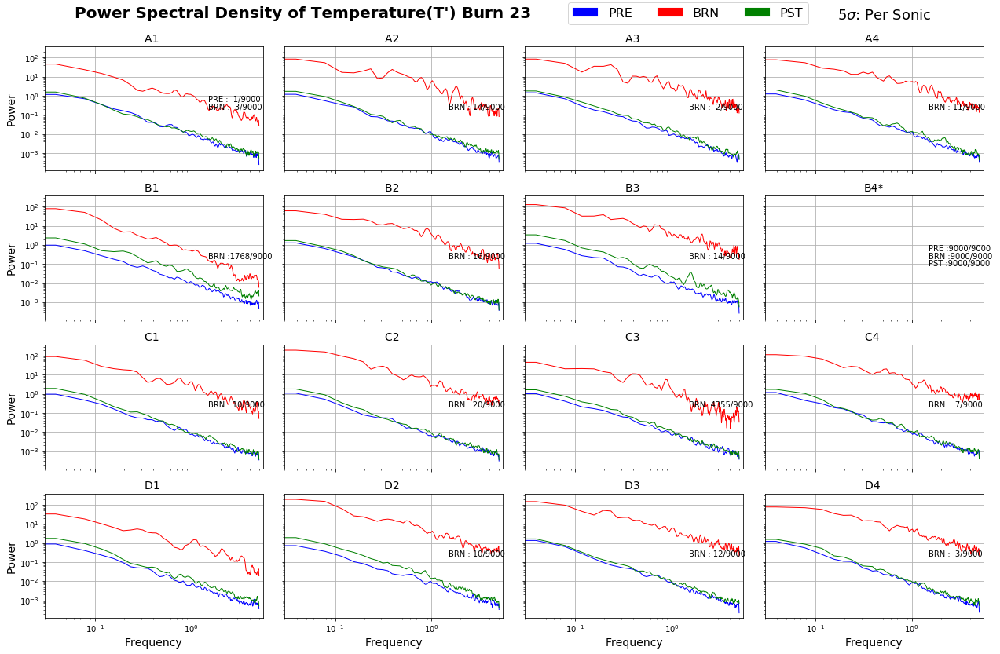

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


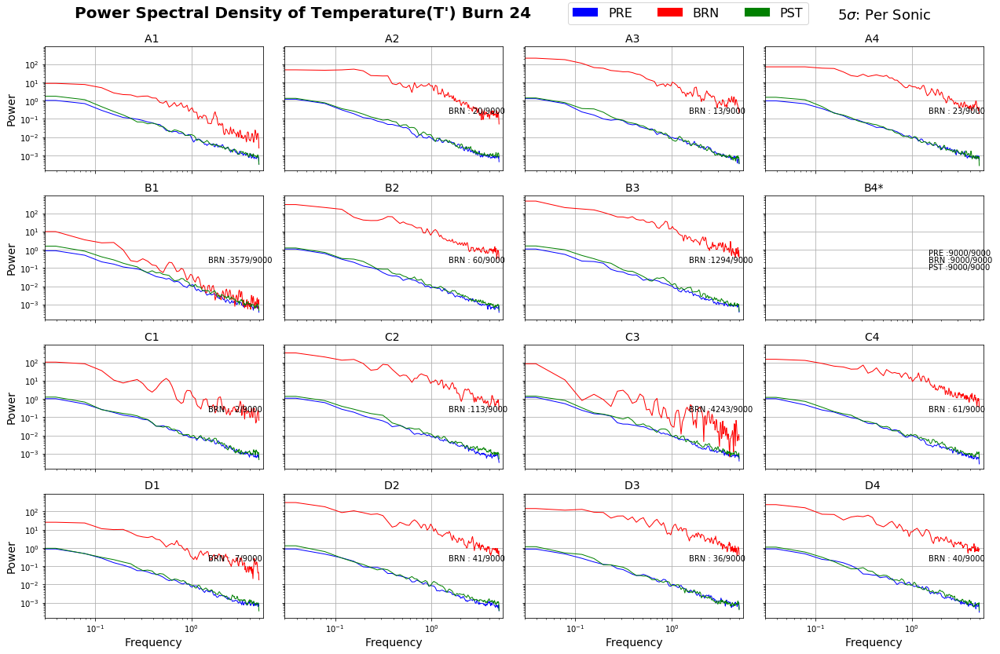

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


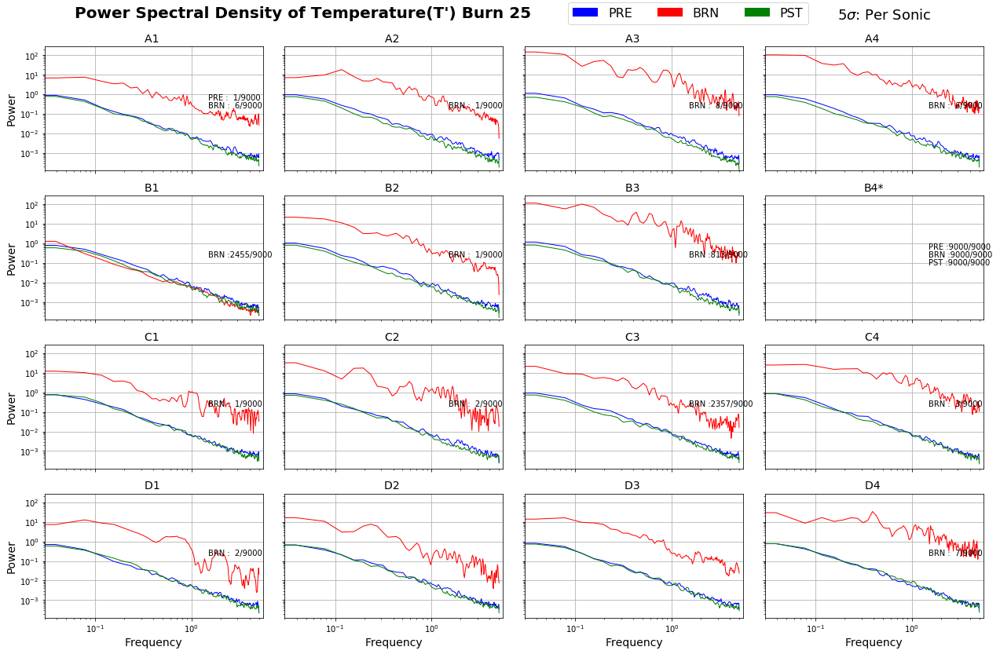

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 72, using nperseg = 72
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 28, using nperseg = 28
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 91, using nperseg = 91
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 78, using nperseg = 78
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\s

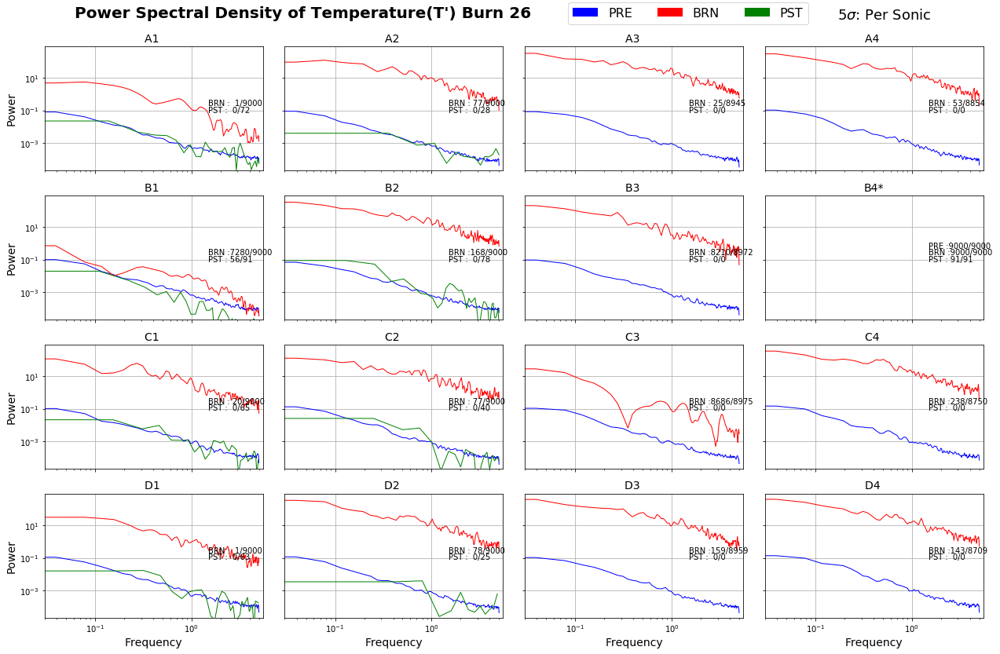

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


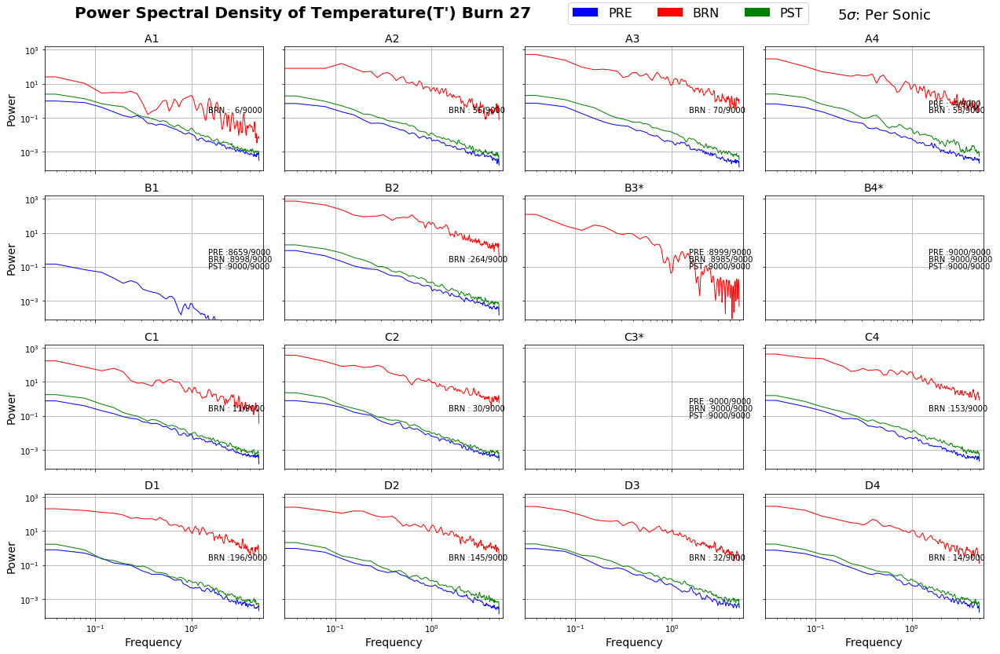

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


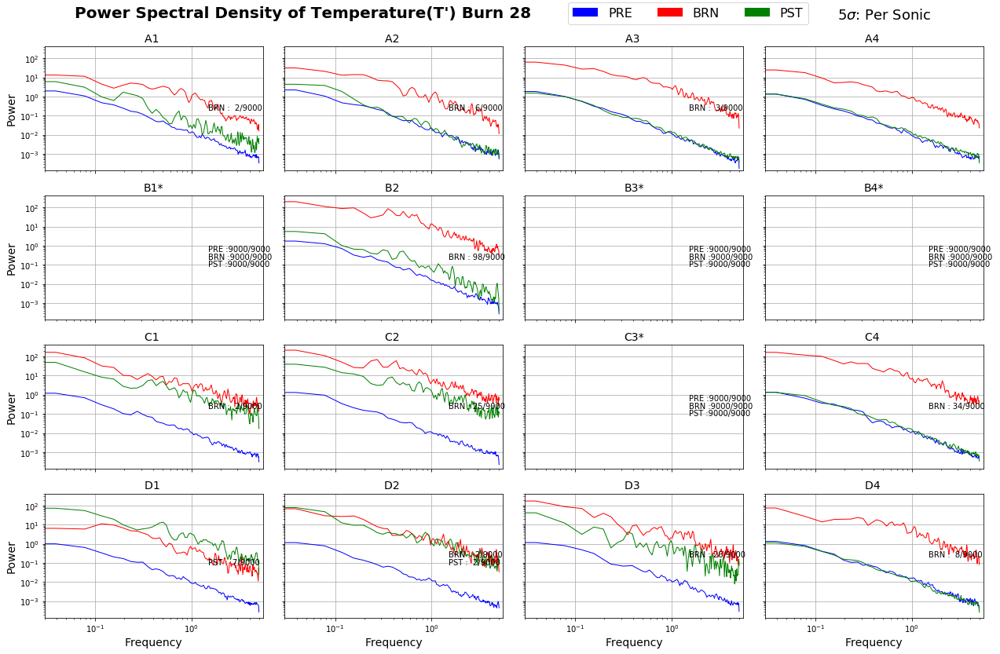

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


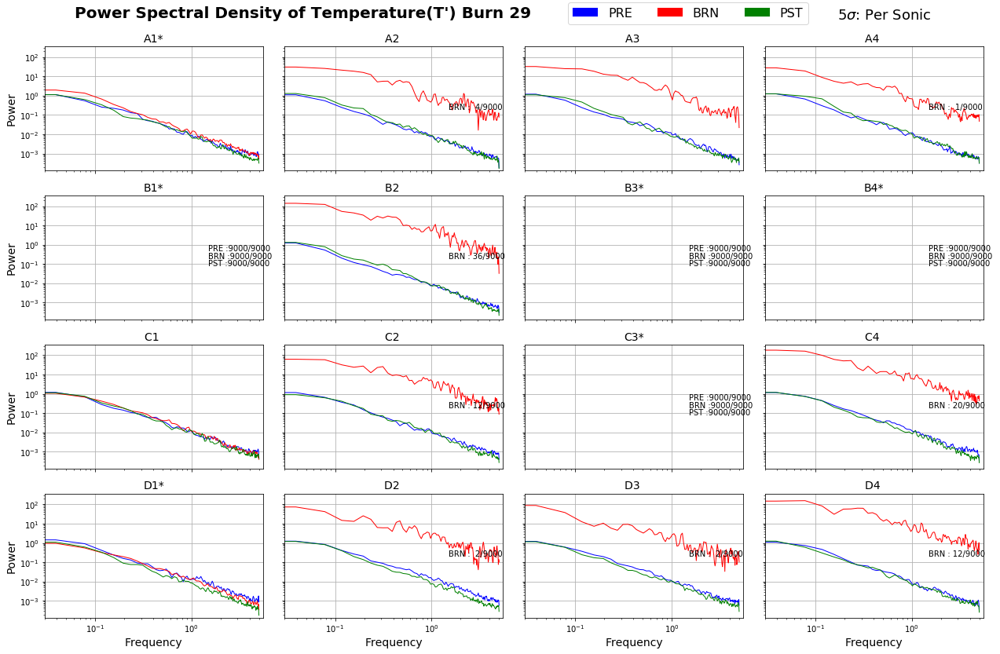

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


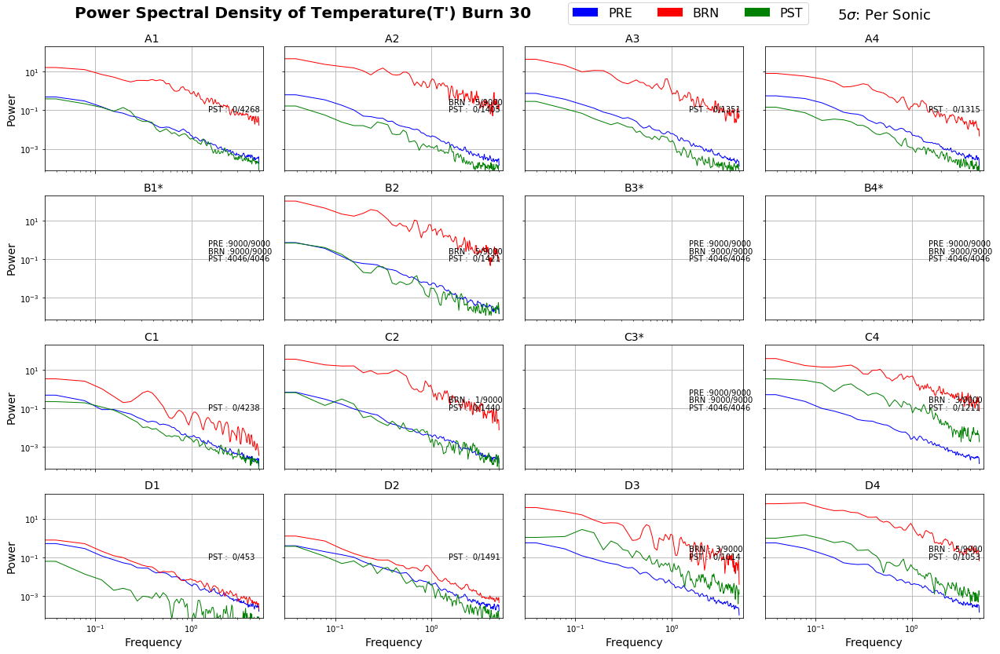

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


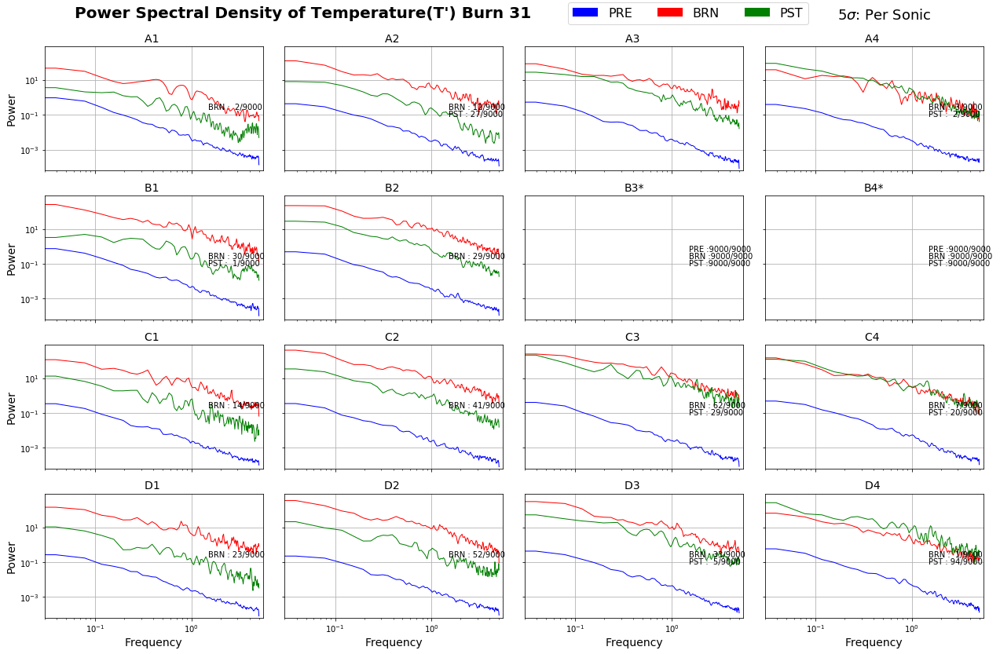

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


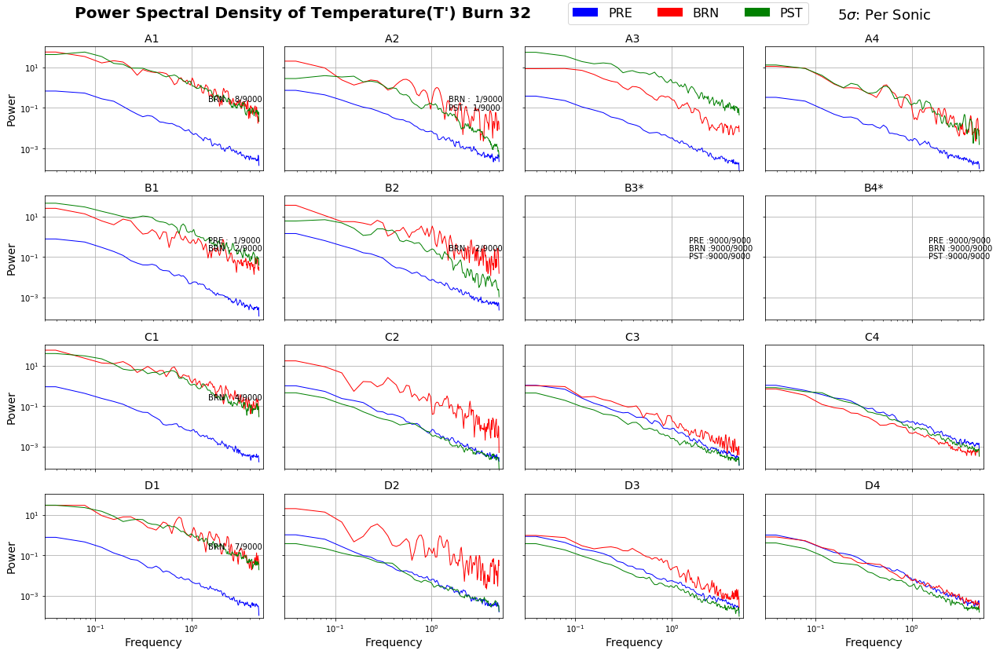

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 200, using nperseg = 200
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 155, using nperseg = 155
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 19, using nperseg = 19
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 188, using nperseg = 188
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 203, using nperseg = 203
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages

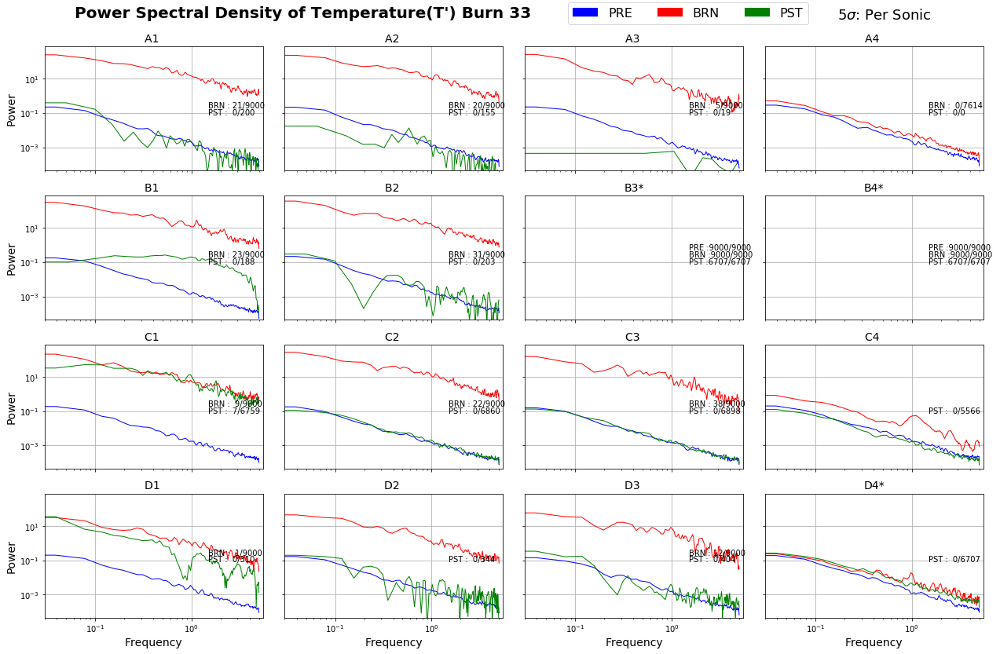

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


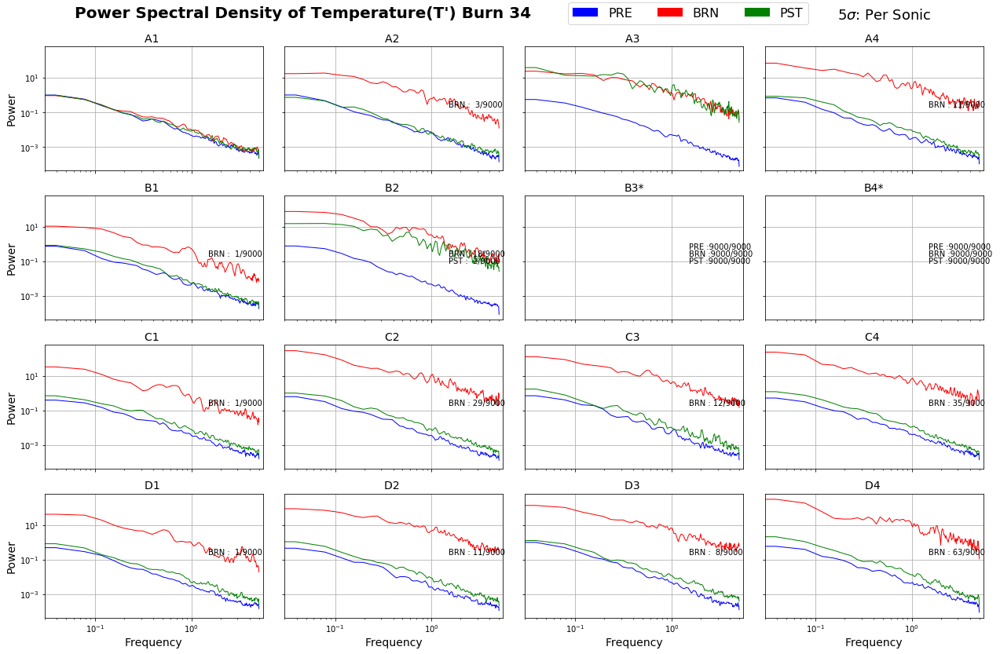

In [5]:
burns = ["01","02","03","04","05","06","07","08","09","11","12","13","18","19","20", \
         "21","22","23","24","25","26","27", "28","29","30","31","32","33","34"]
for i in range(len(burns)):
    #welch_power_spec(burns[i], "T",True)
    welch_power_spec(burns[i], "T",False)

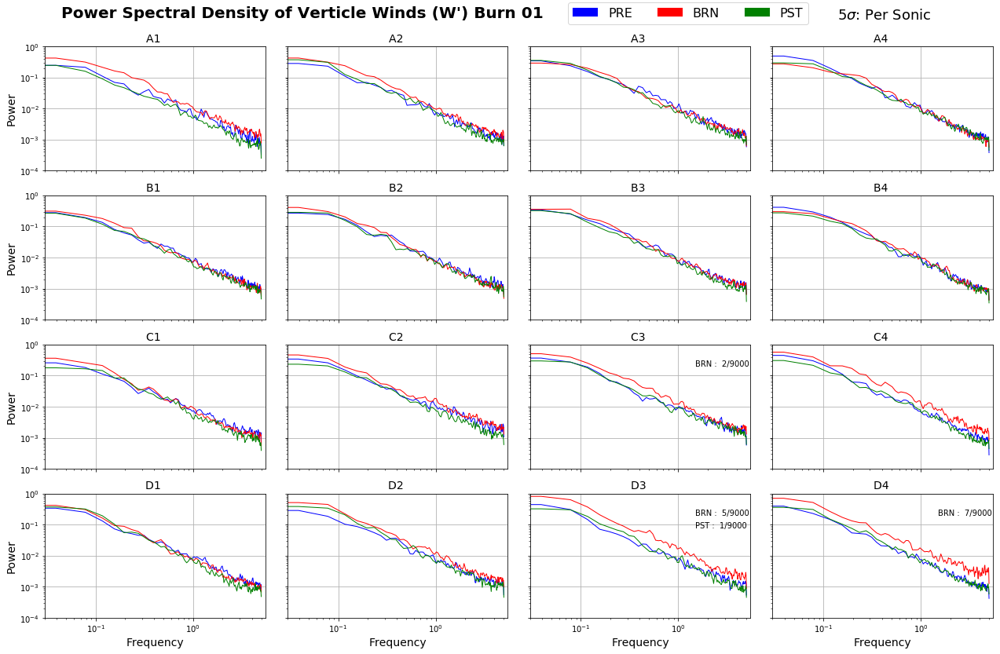

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 29, using nperseg = 29
  .format(nperseg, input_length))


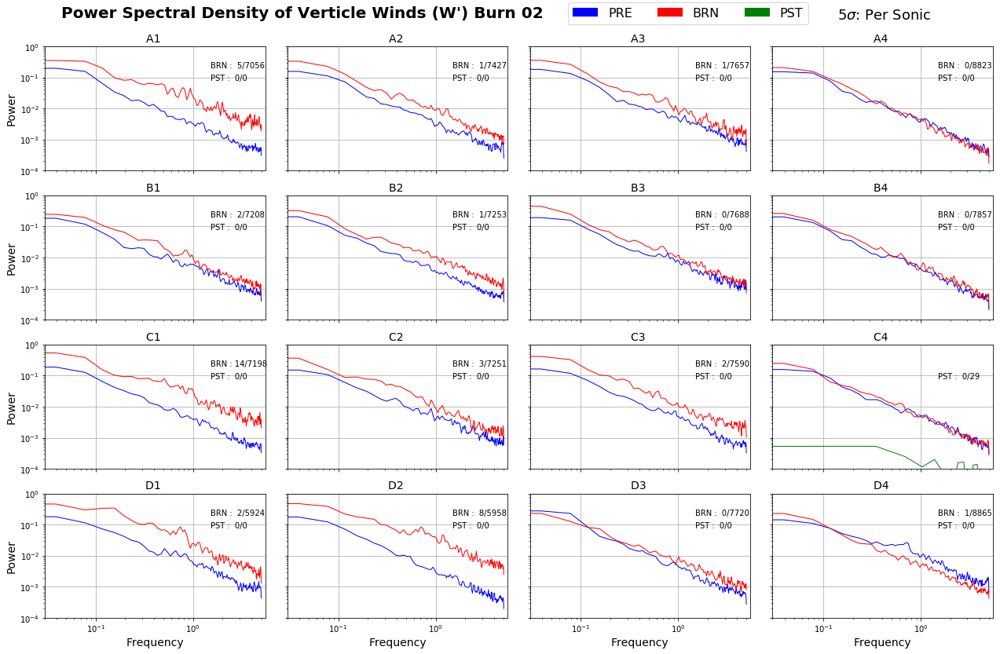

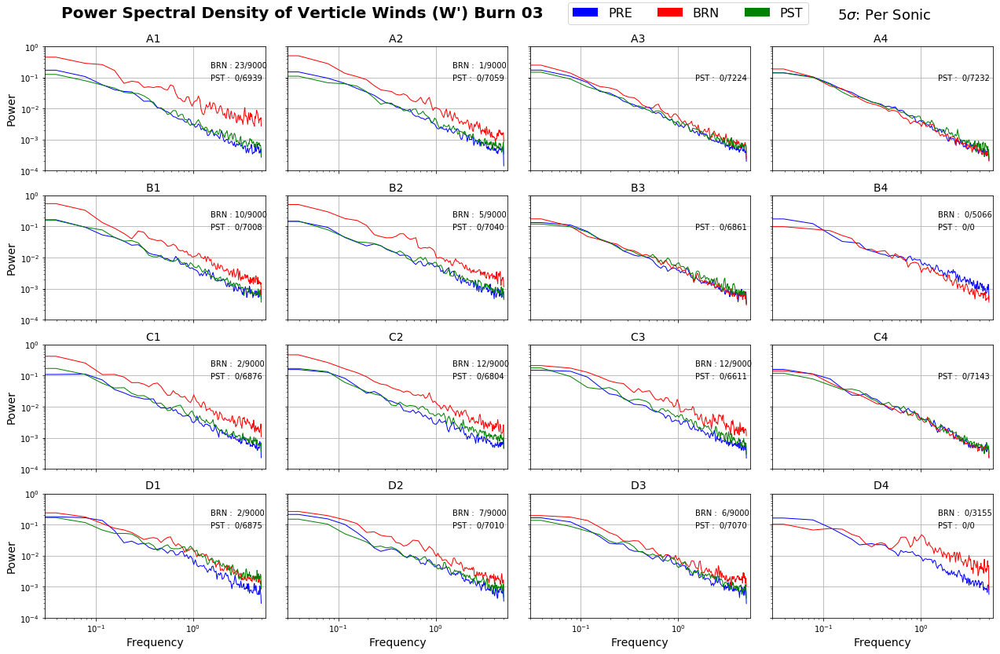

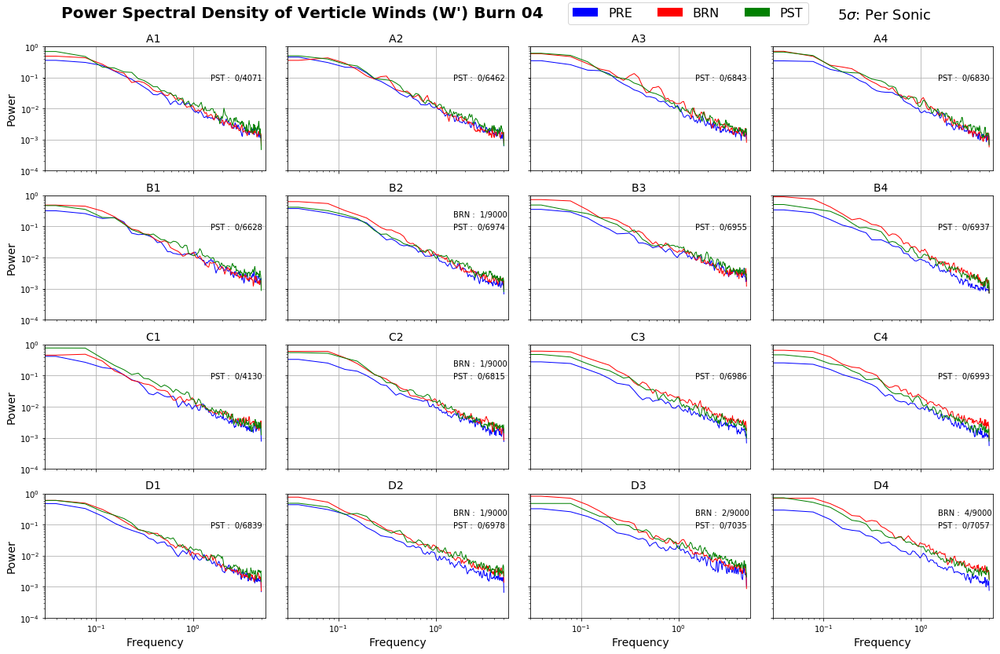

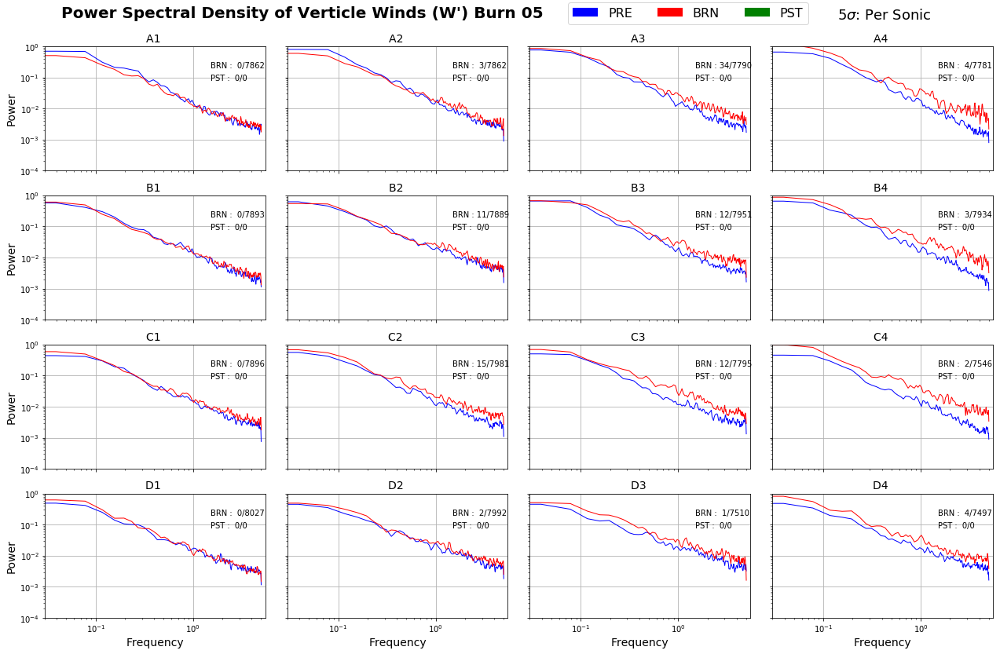

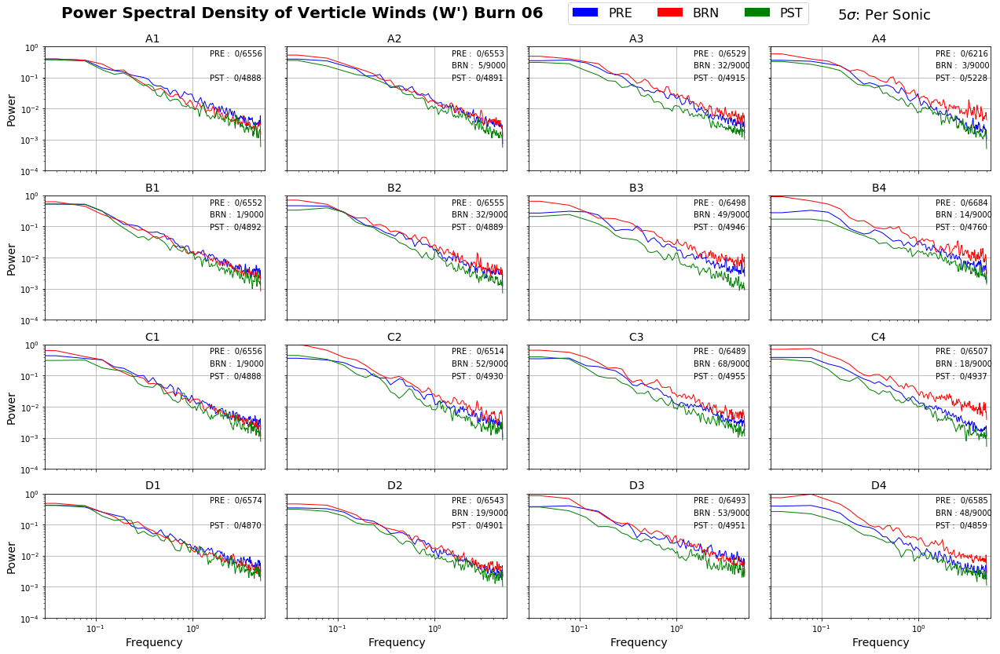

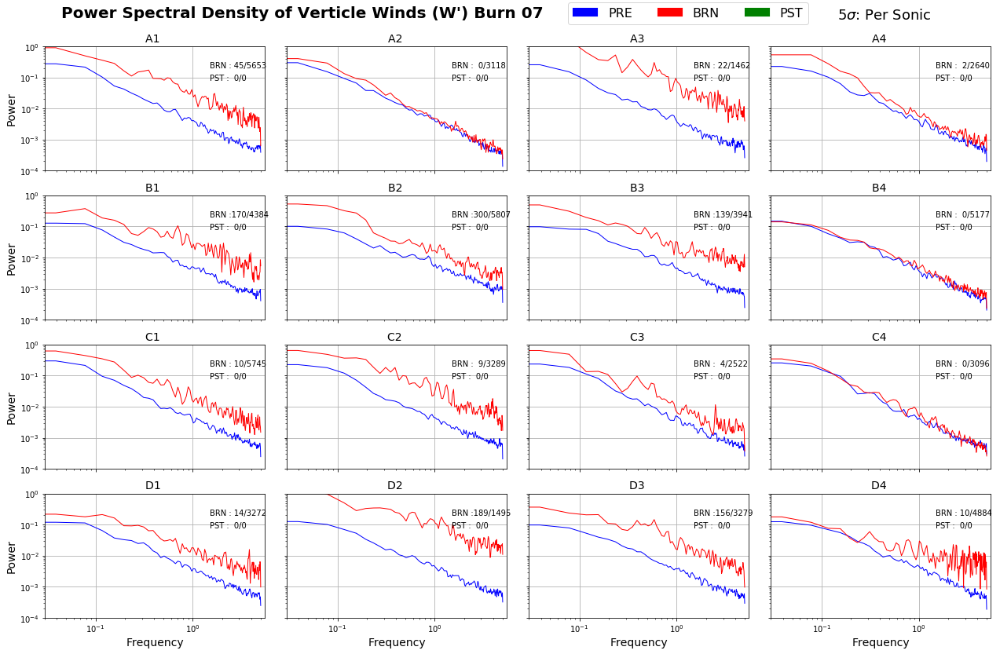

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


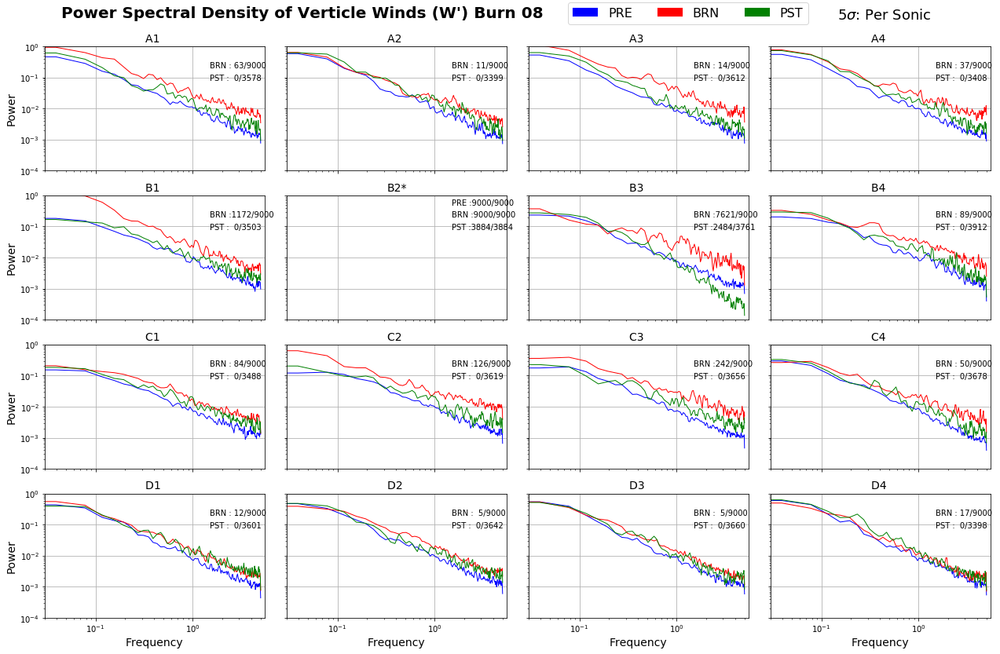

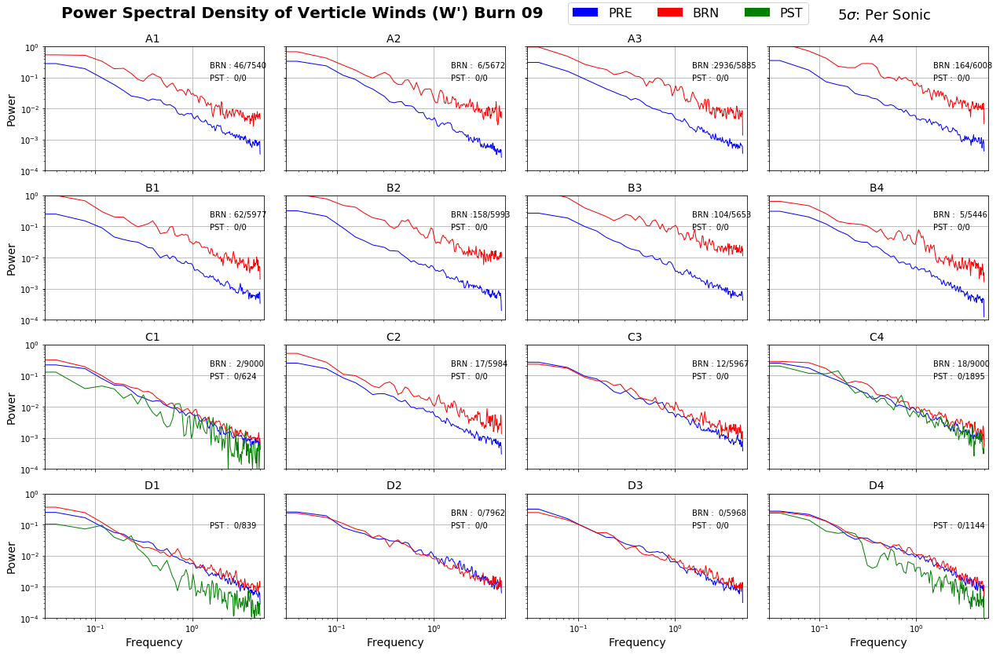

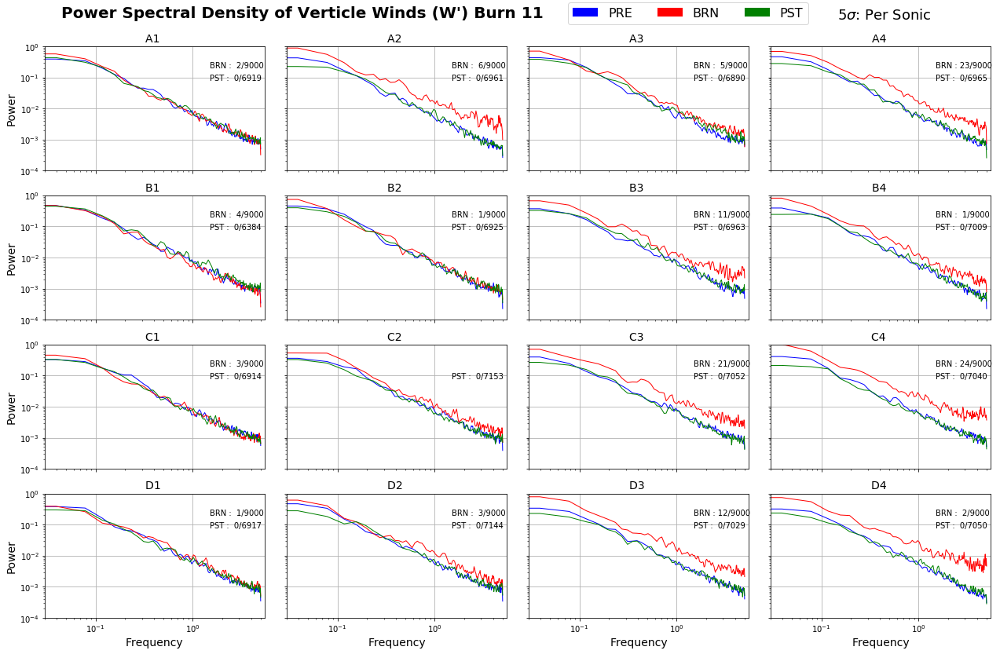

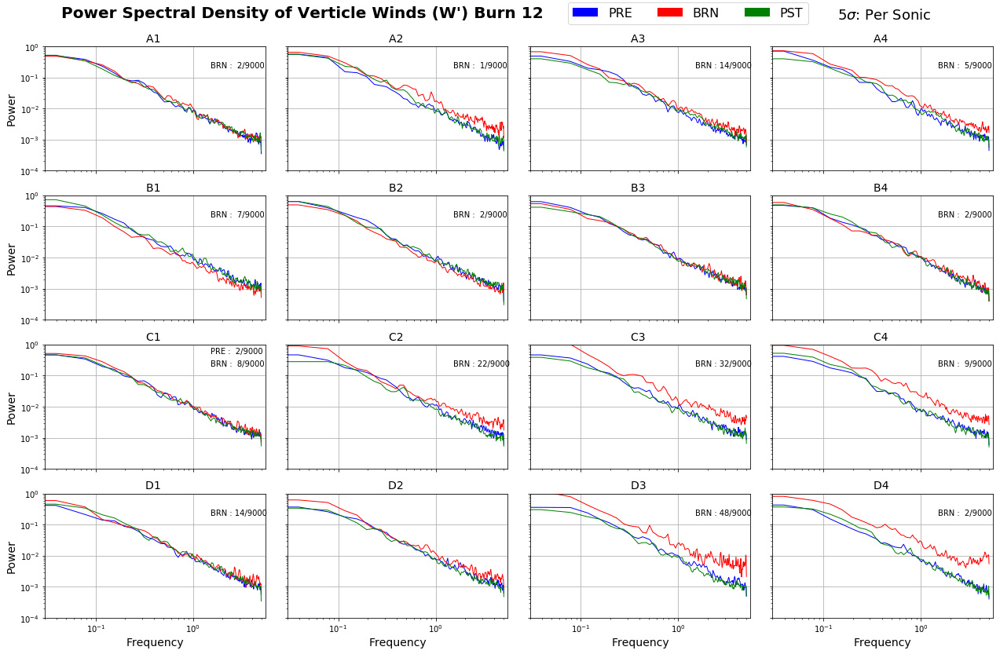

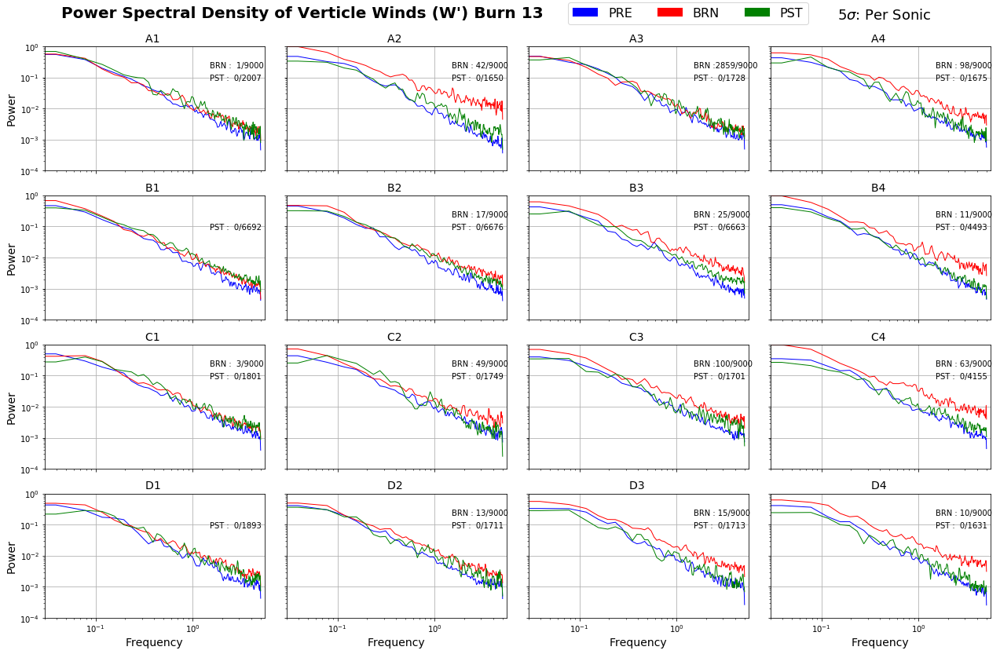

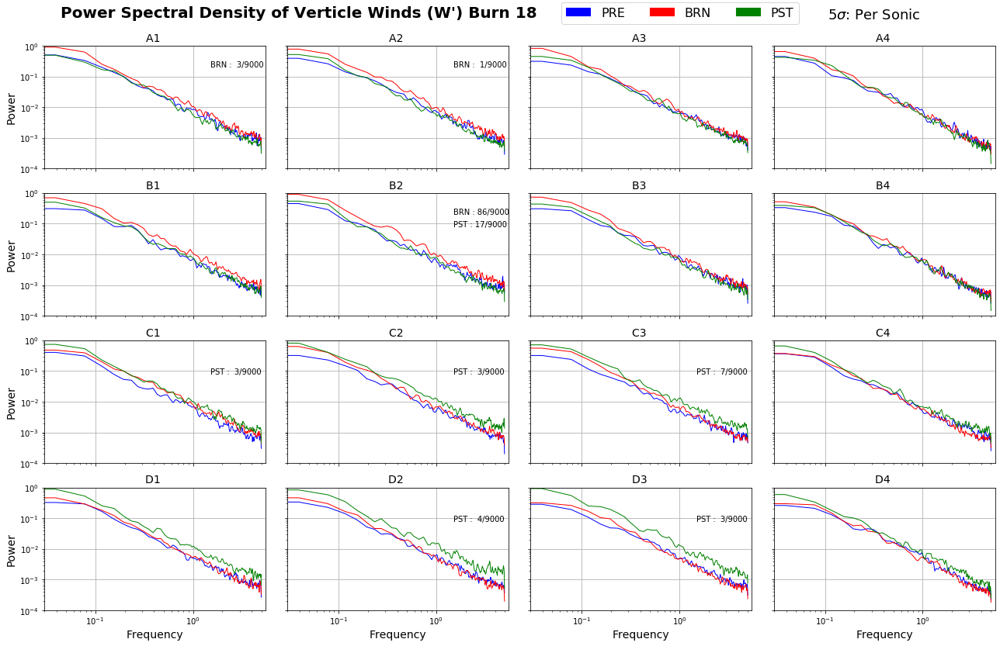

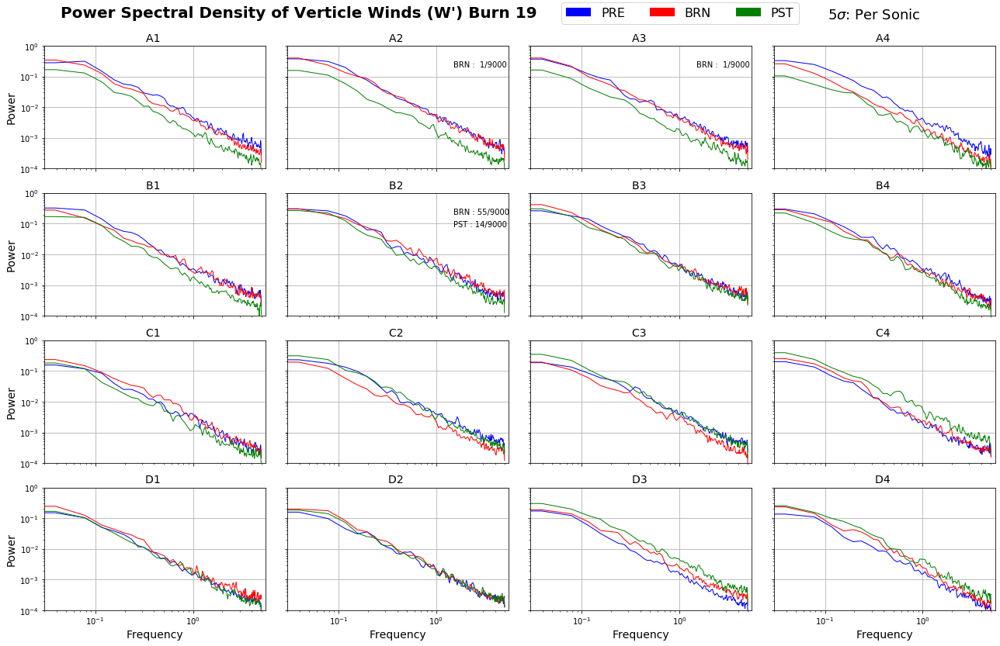

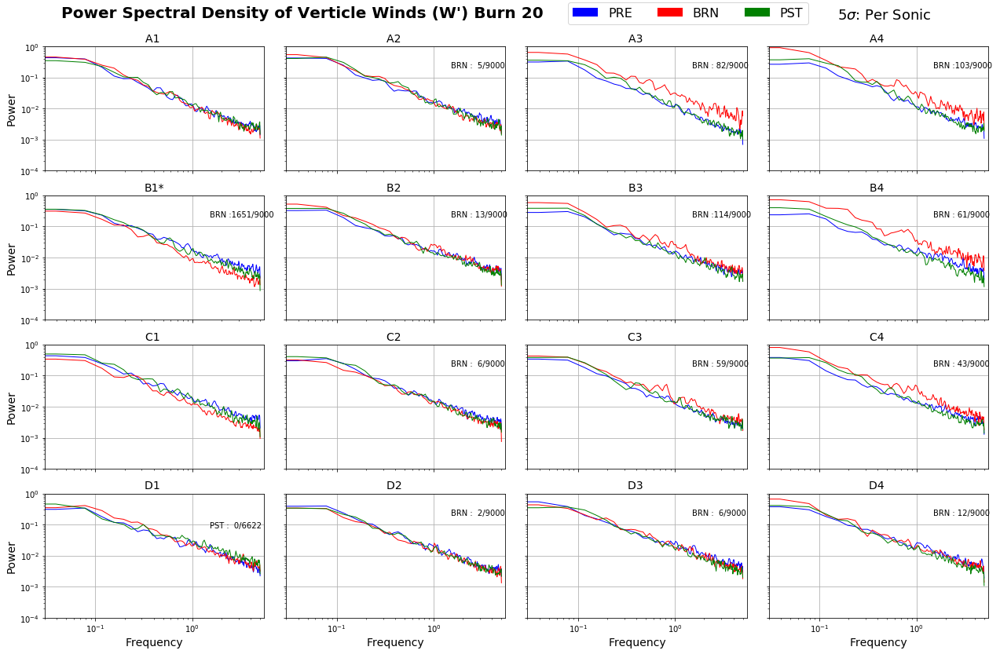

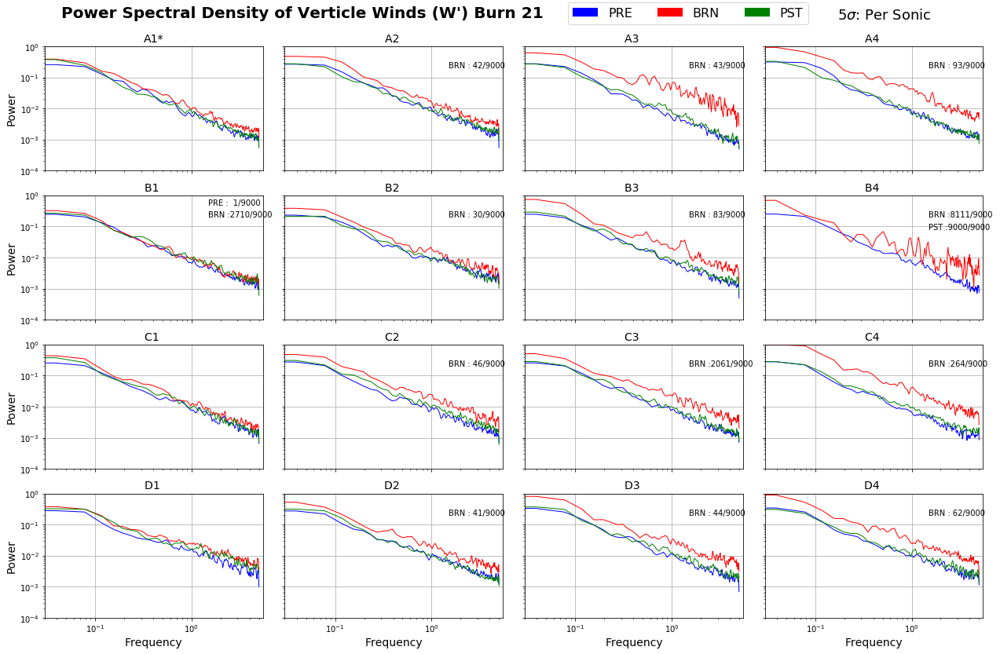

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 246, using nperseg = 246
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 244, using nperseg = 244
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 234, using nperseg = 234
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 217, using nperseg = 217
  .format(nperseg, input_length))


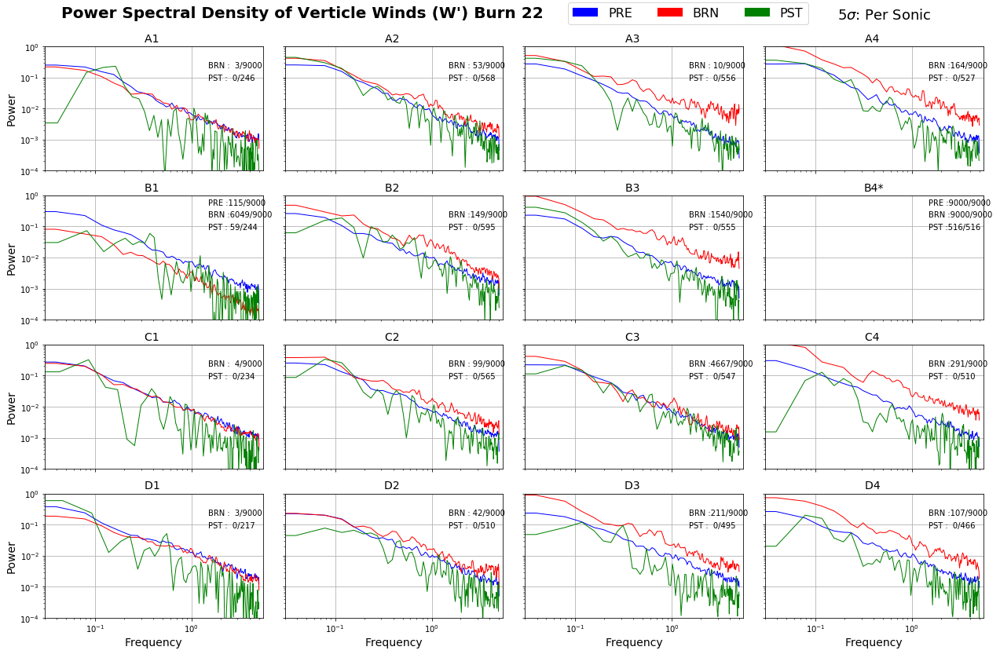

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


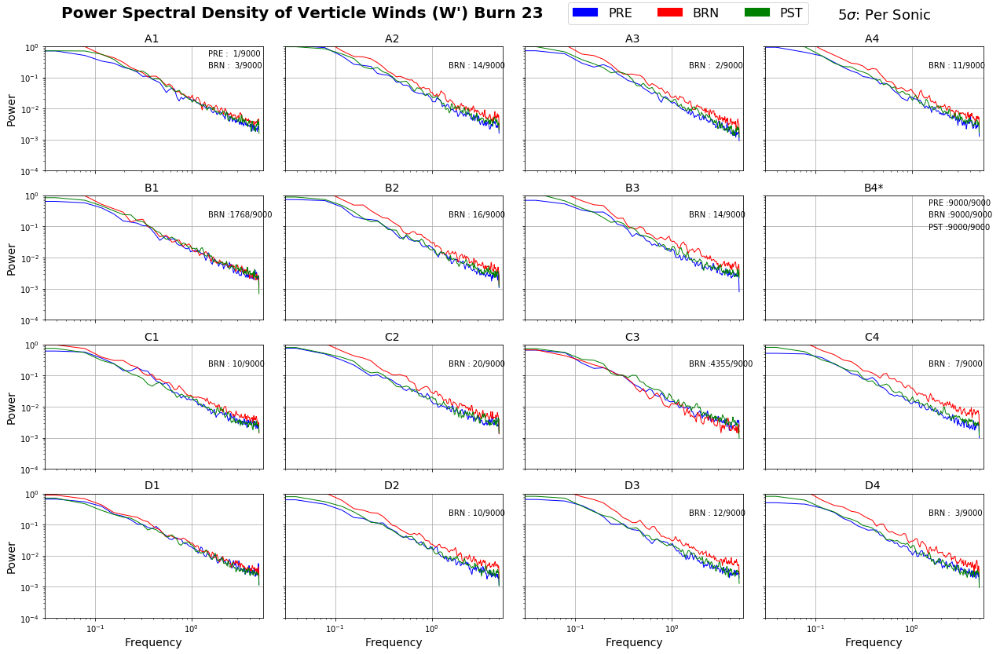

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


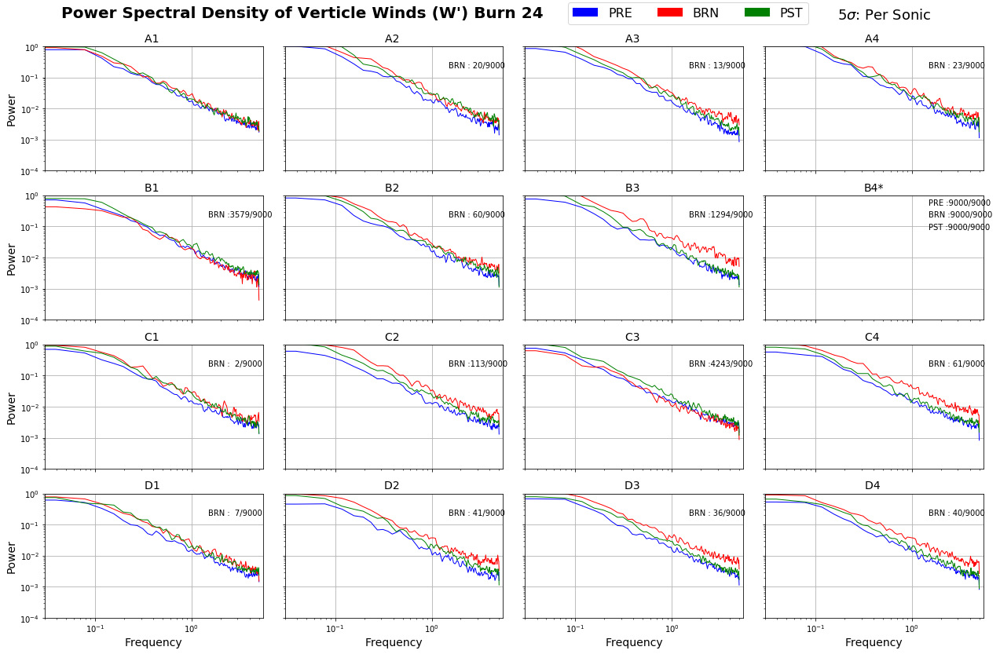

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


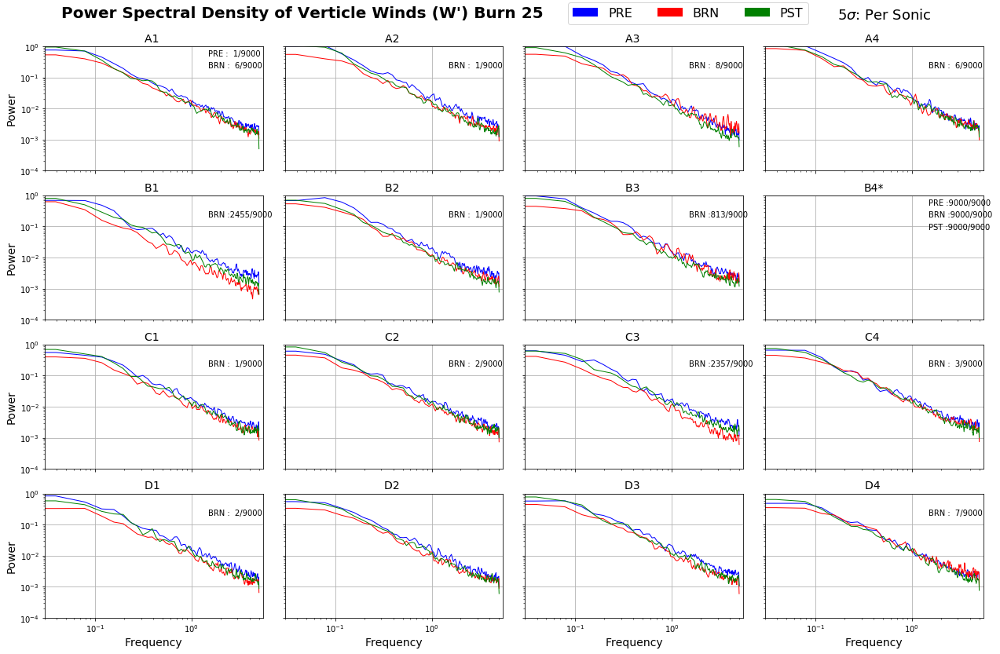

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 72, using nperseg = 72
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 28, using nperseg = 28
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 91, using nperseg = 91
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 78, using nperseg = 78
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\s

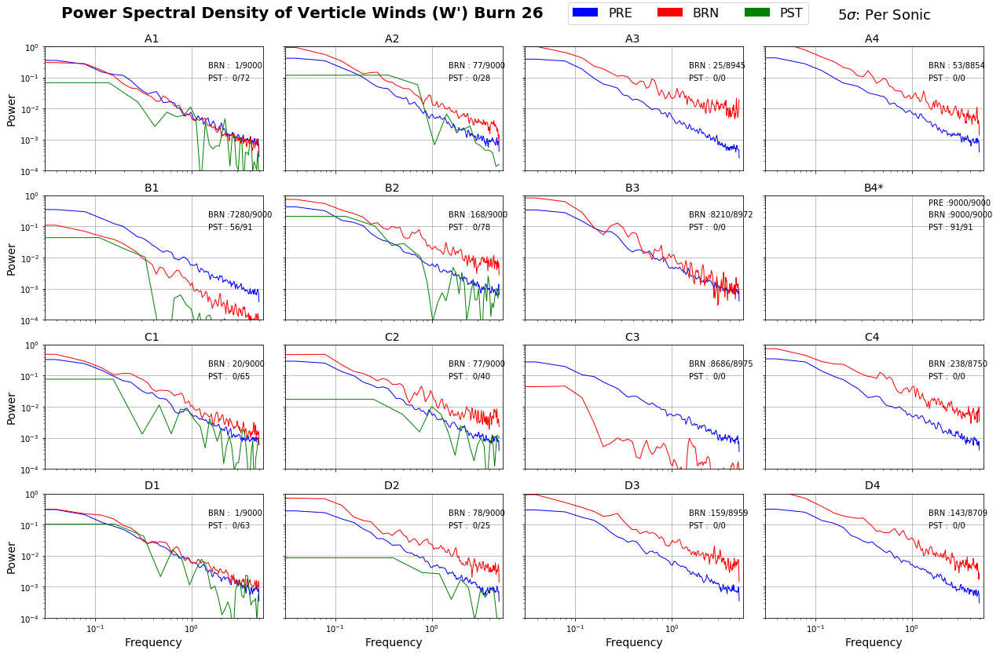

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


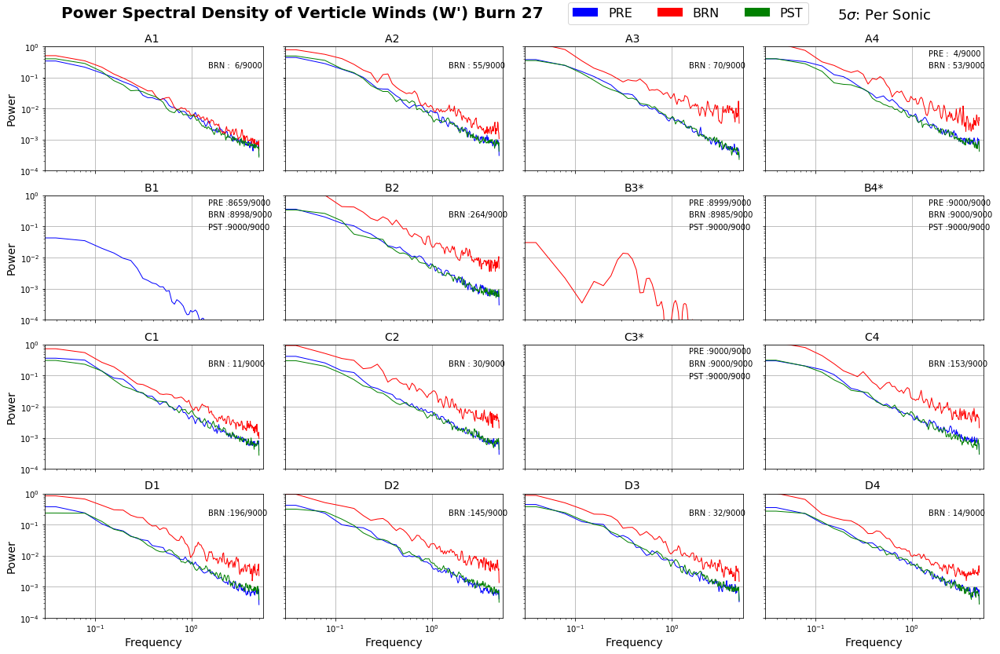

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


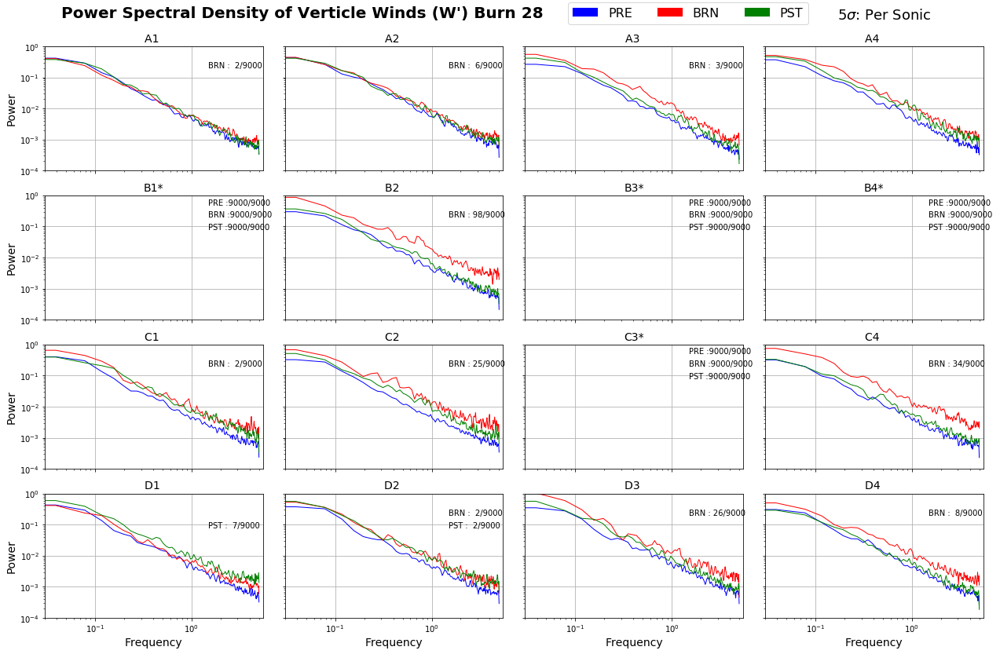

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


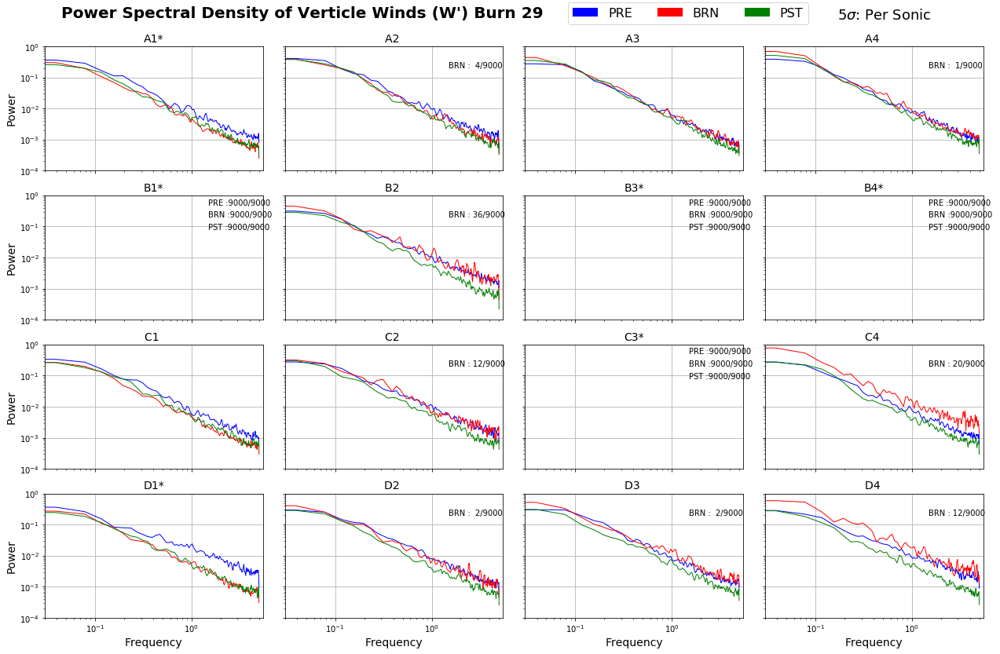

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


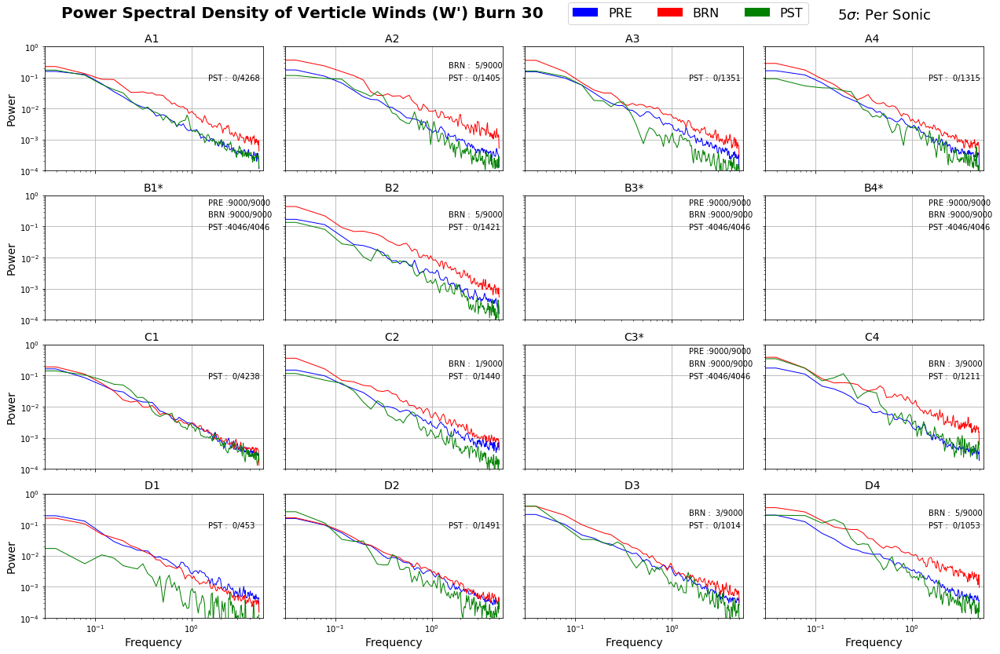

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


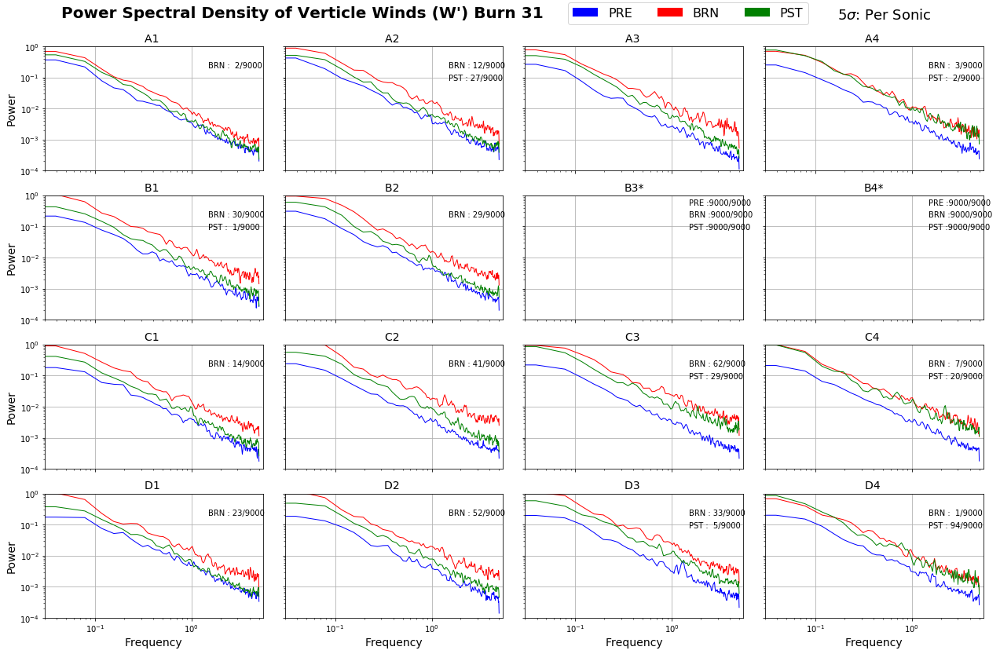

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


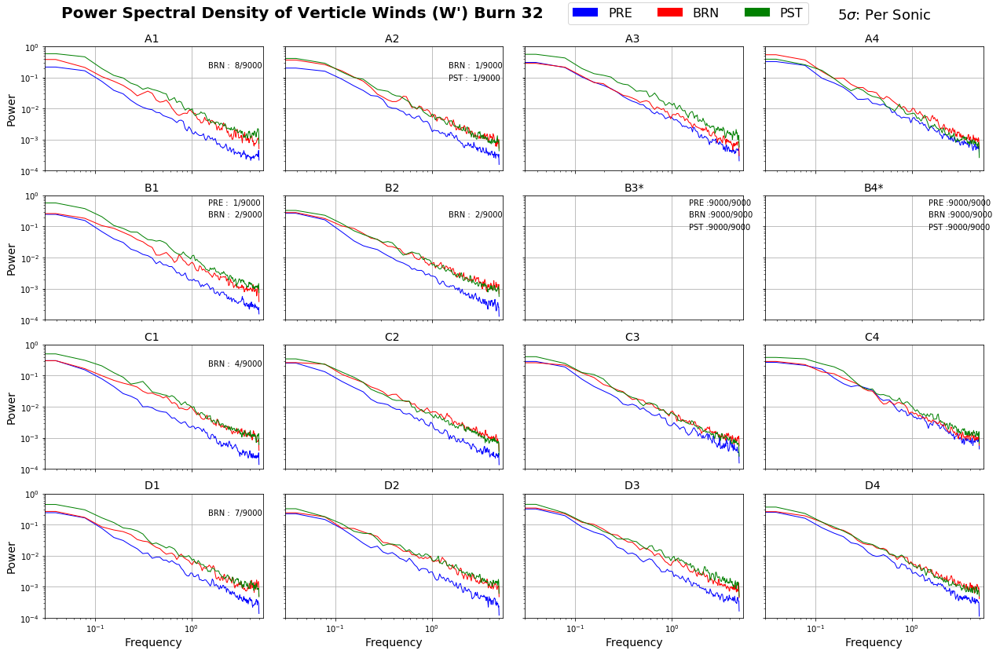

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 200, using nperseg = 200
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 155, using nperseg = 155
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 19, using nperseg = 19
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 188, using nperseg = 188
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 203, using nperseg = 203
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages

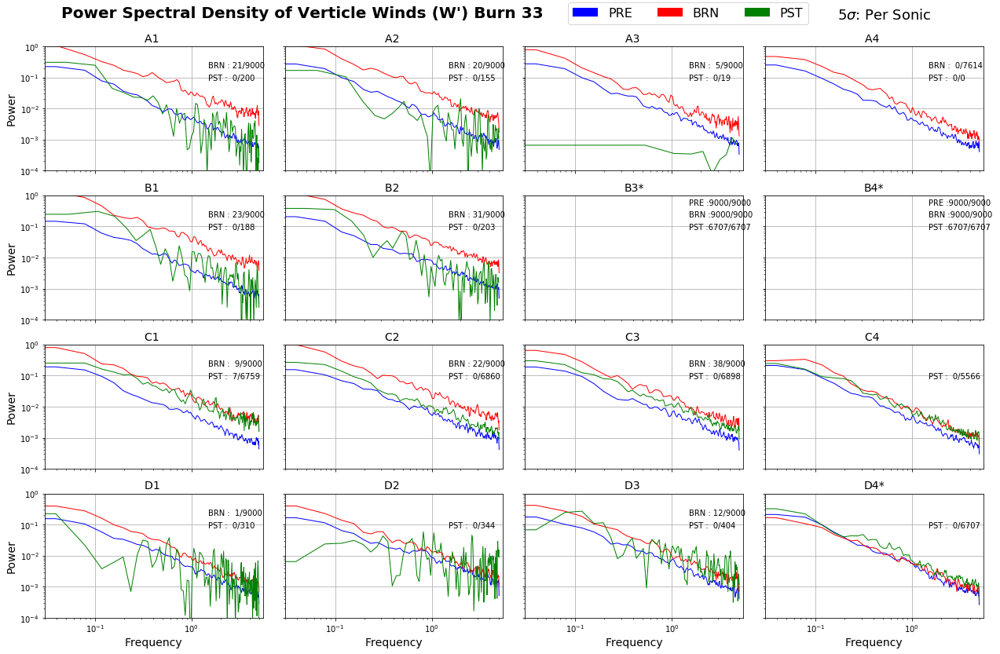

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


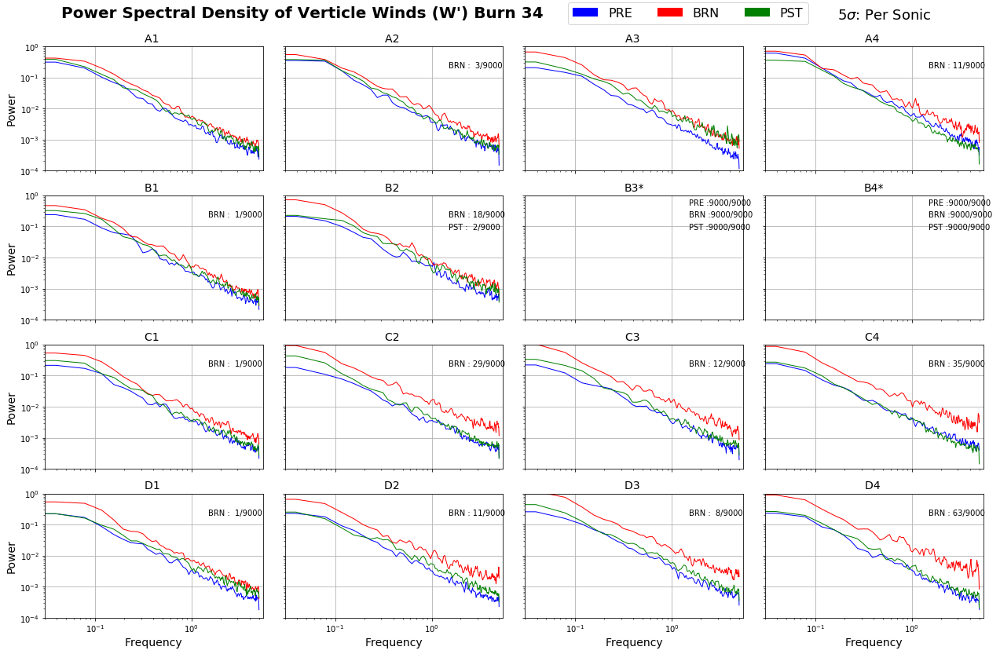

In [6]:
burns = ["01","02","03","04","05","06","07","08","09","11","12","13","18","19","20", \
         "21","22","23","24","25","26","27", "28","29","30","31","32","33","34"]
for i in range(len(burns)):
    #welch_power_spec(burns[i], "W",True)
    welch_power_spec(burns[i], "W",False)

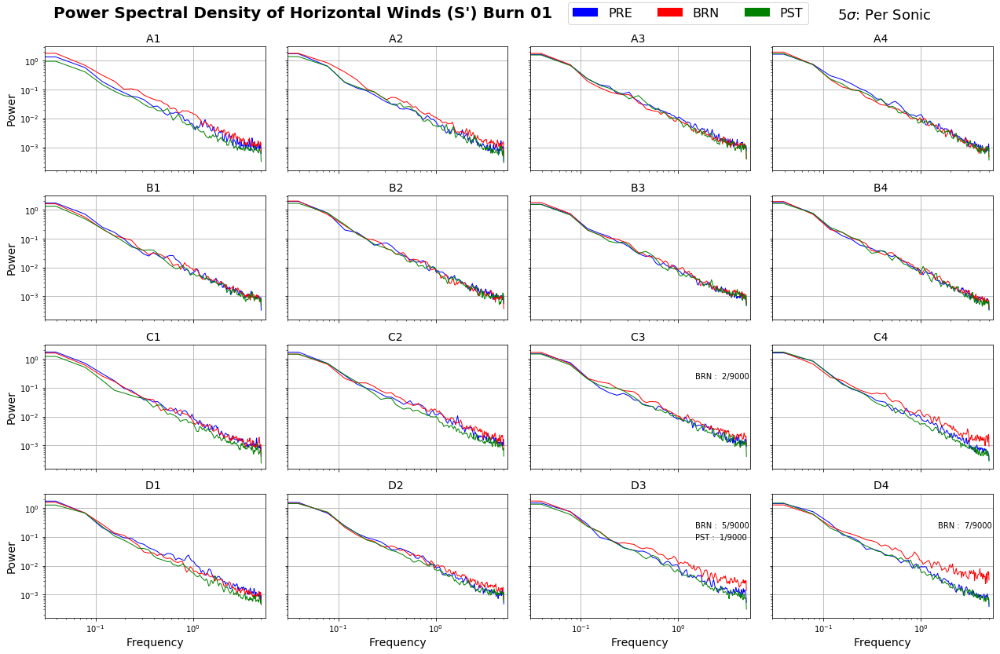

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 29, using nperseg = 29
  .format(nperseg, input_length))


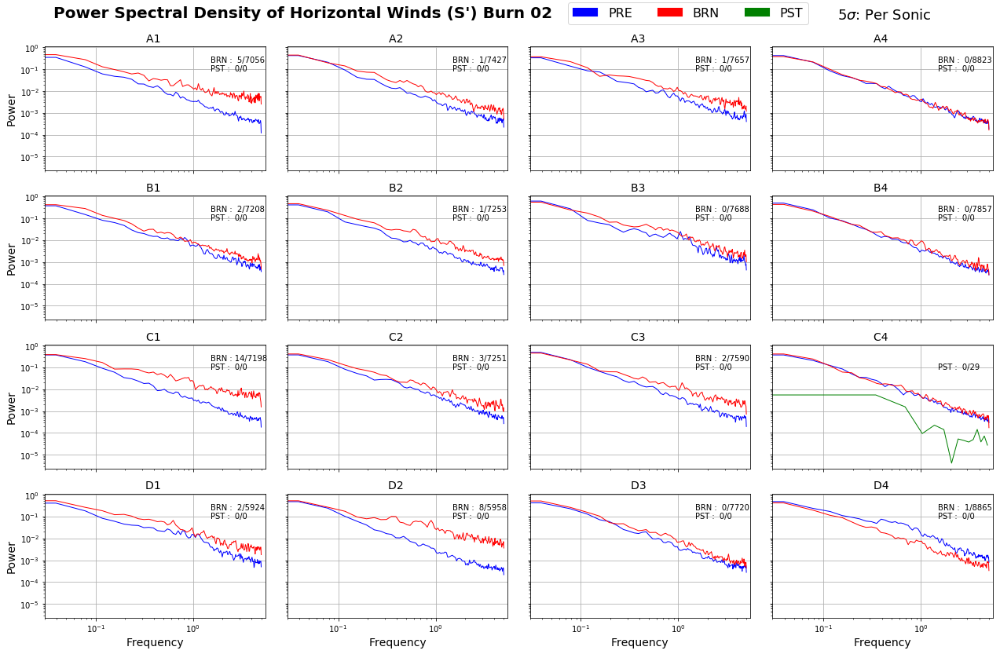

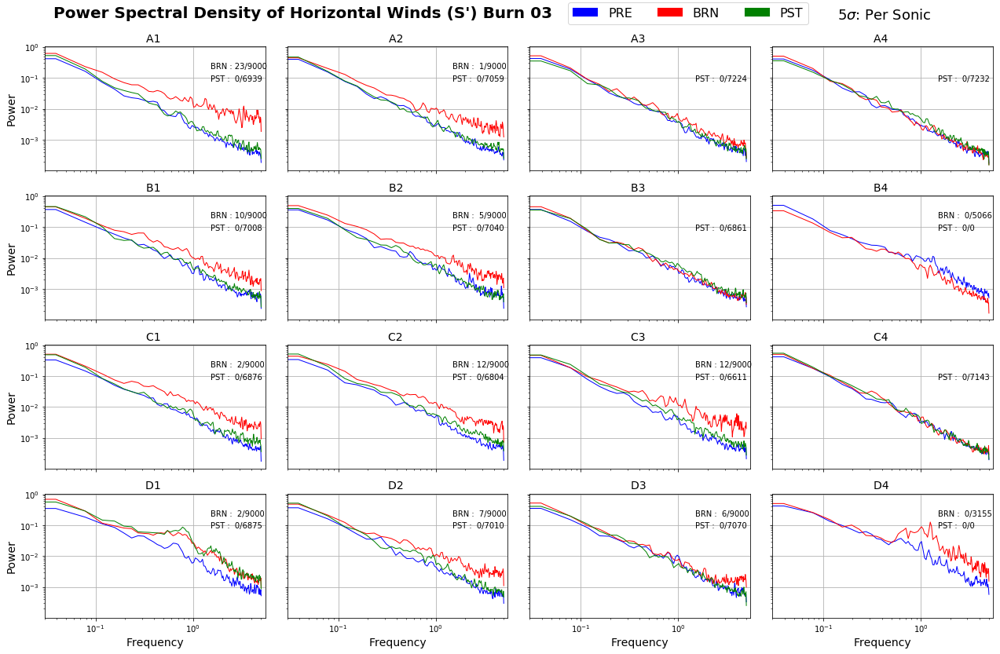

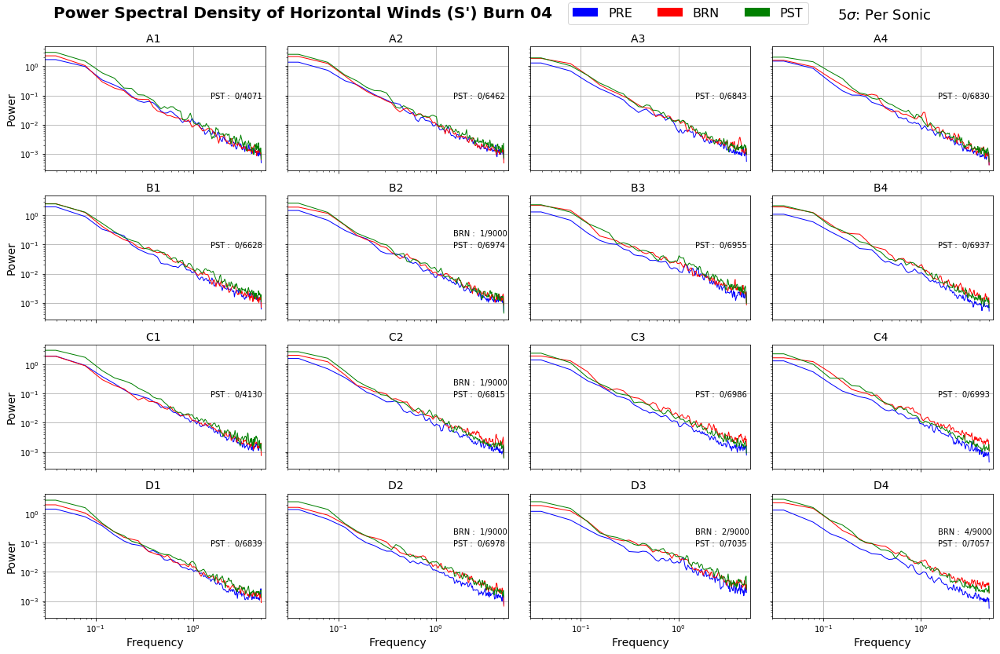

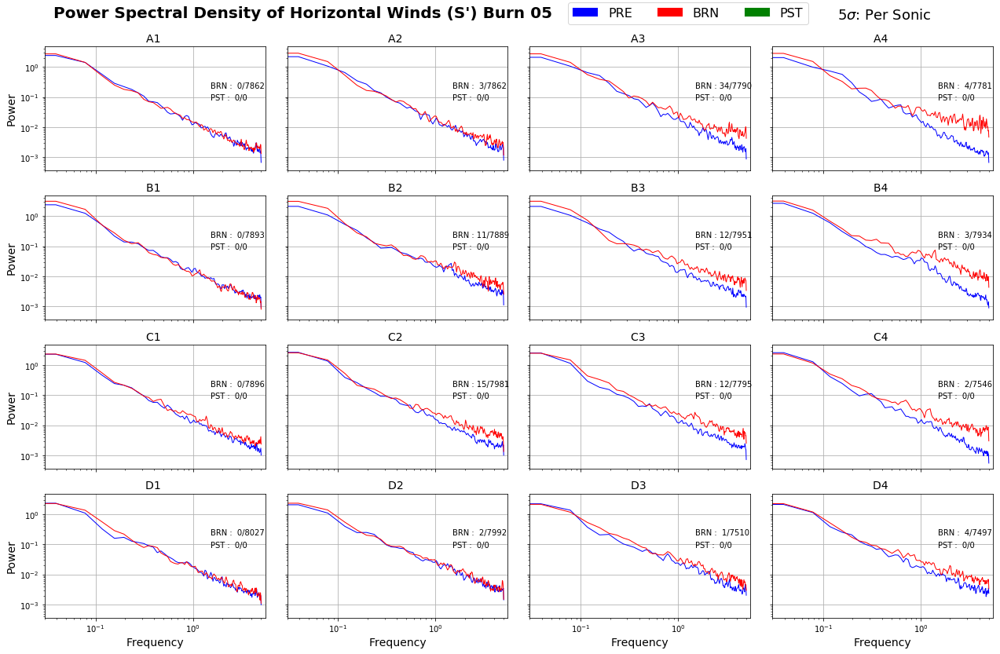

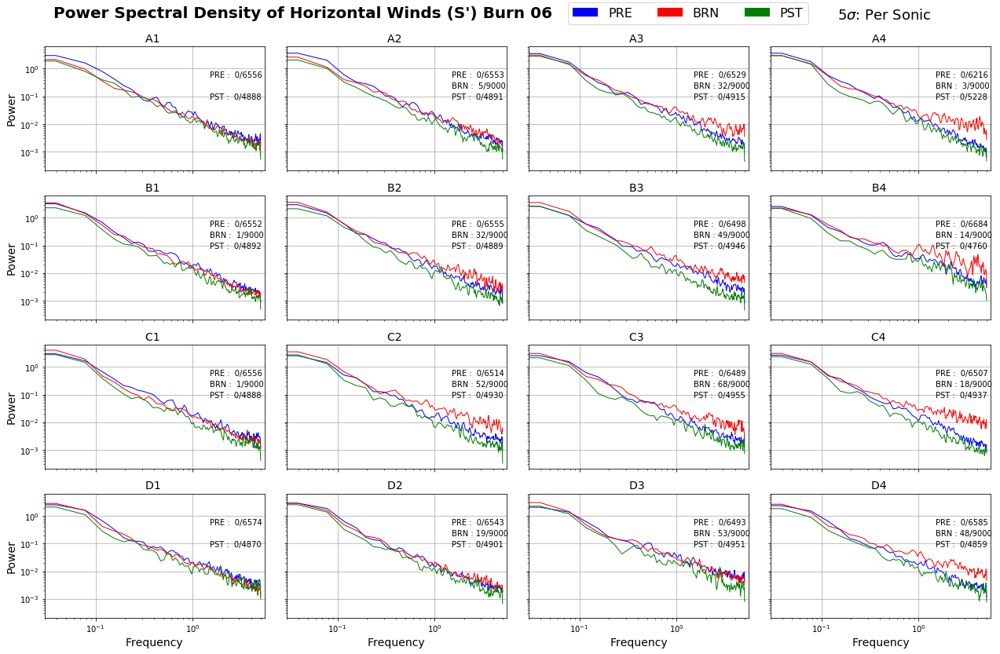

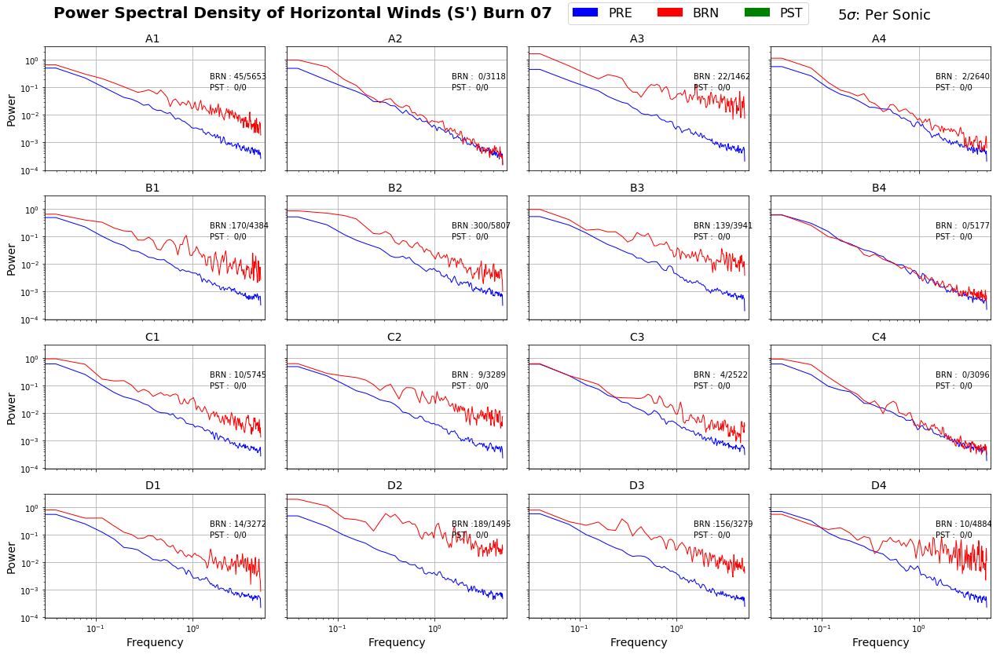

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


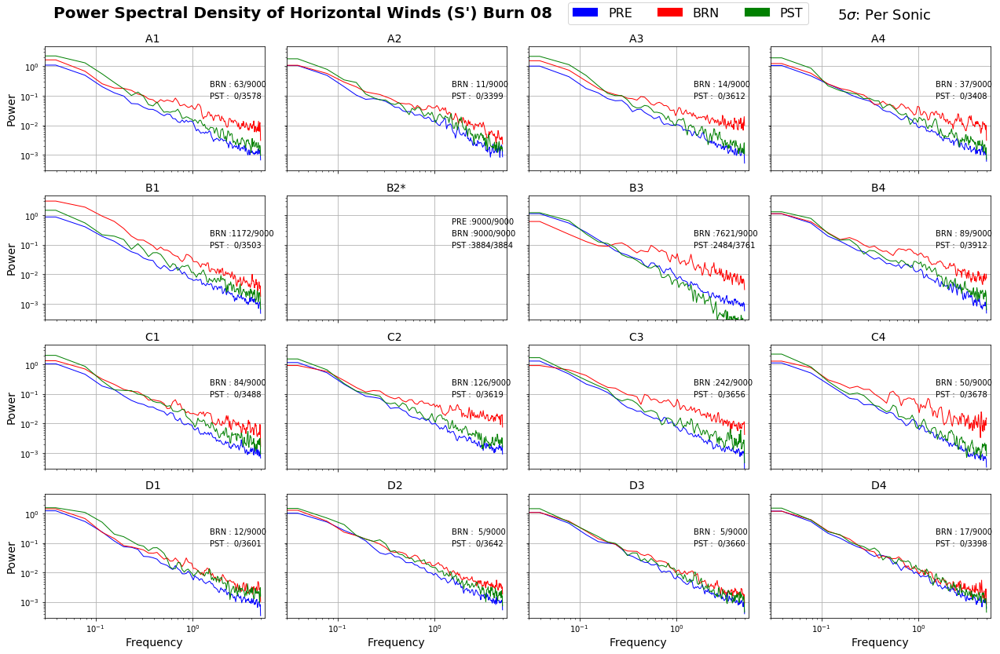

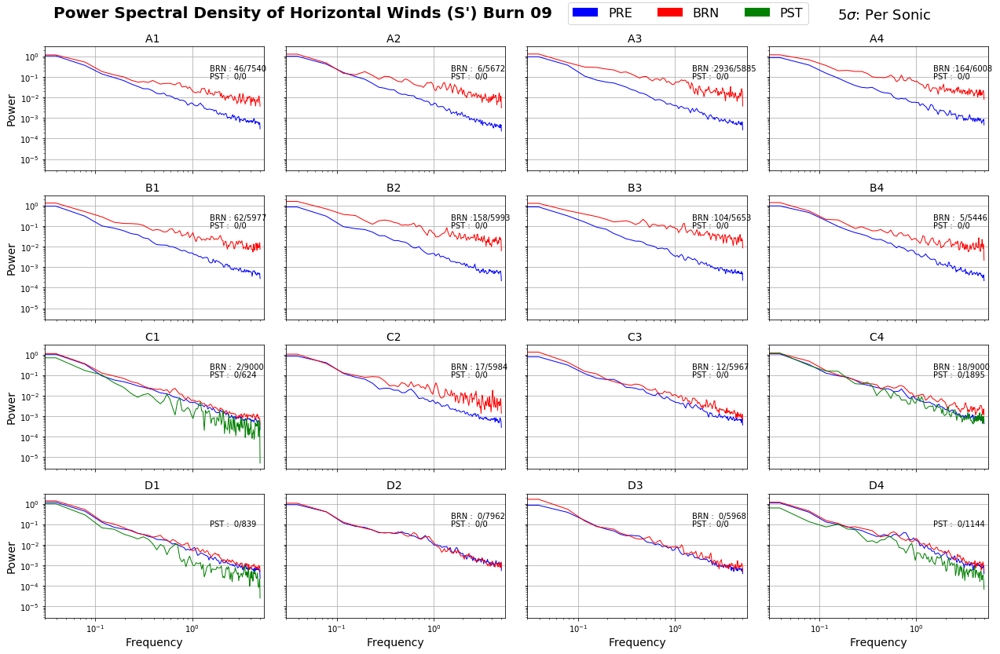

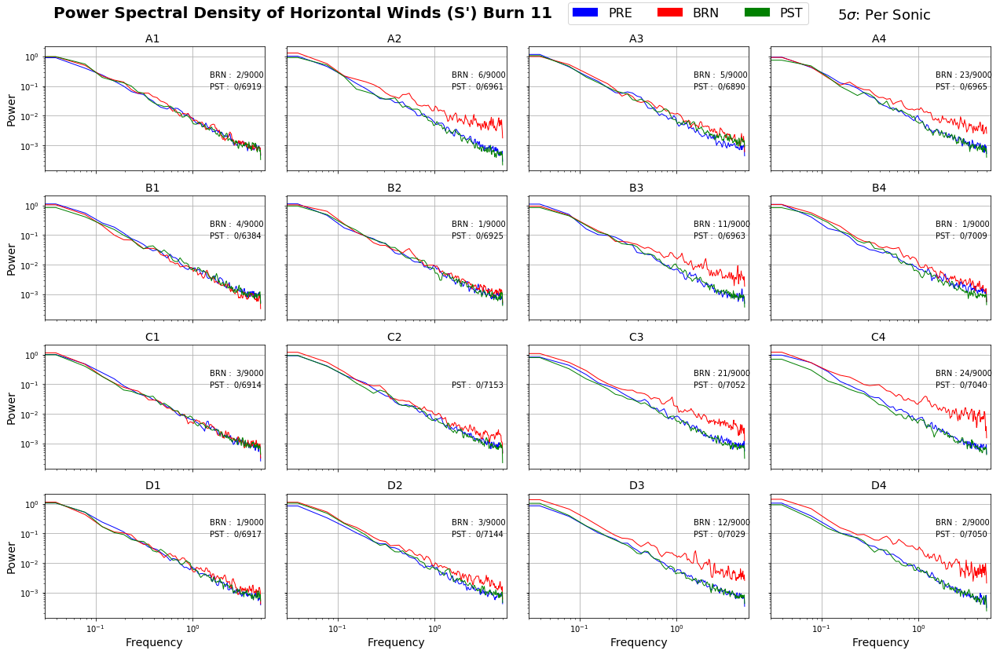

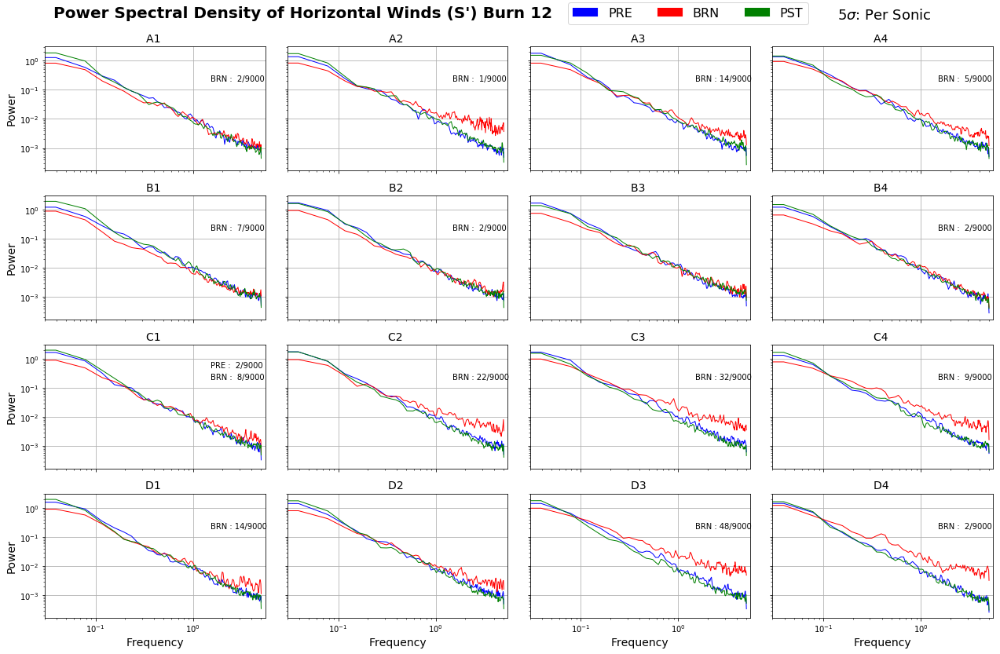

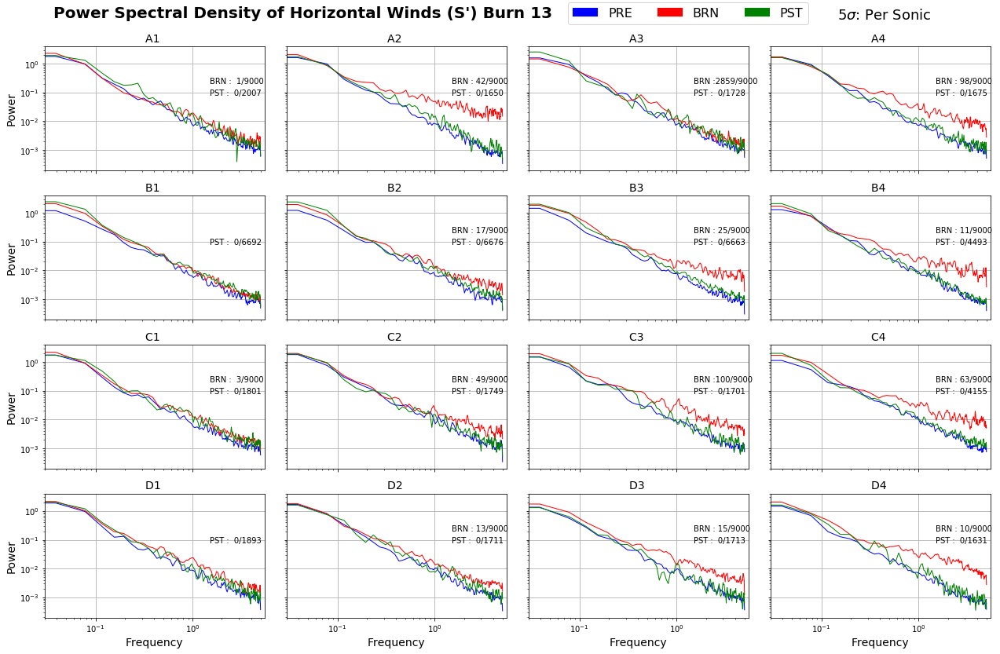

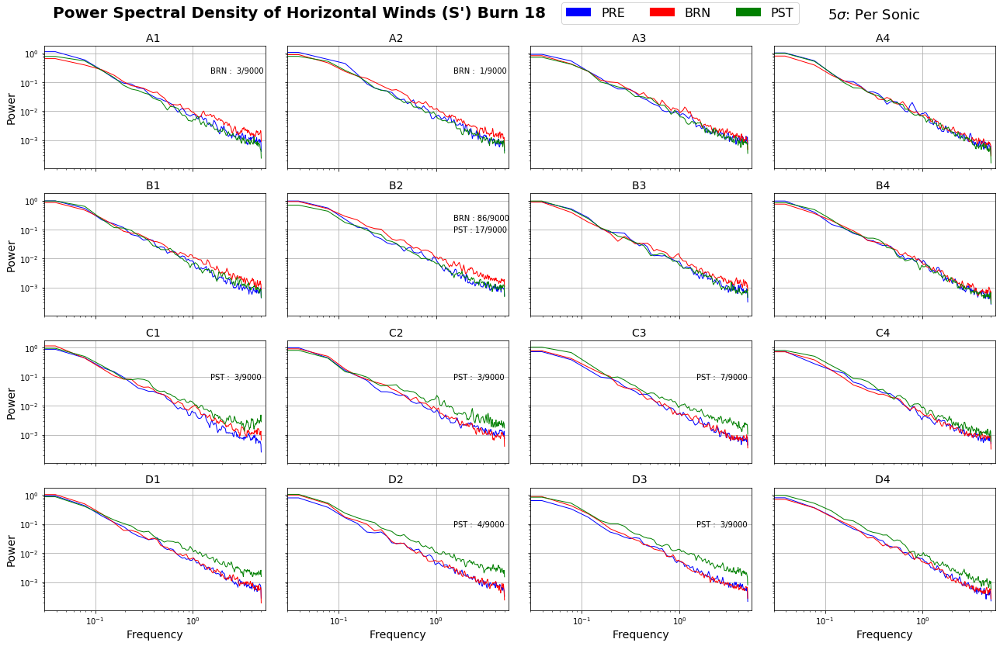

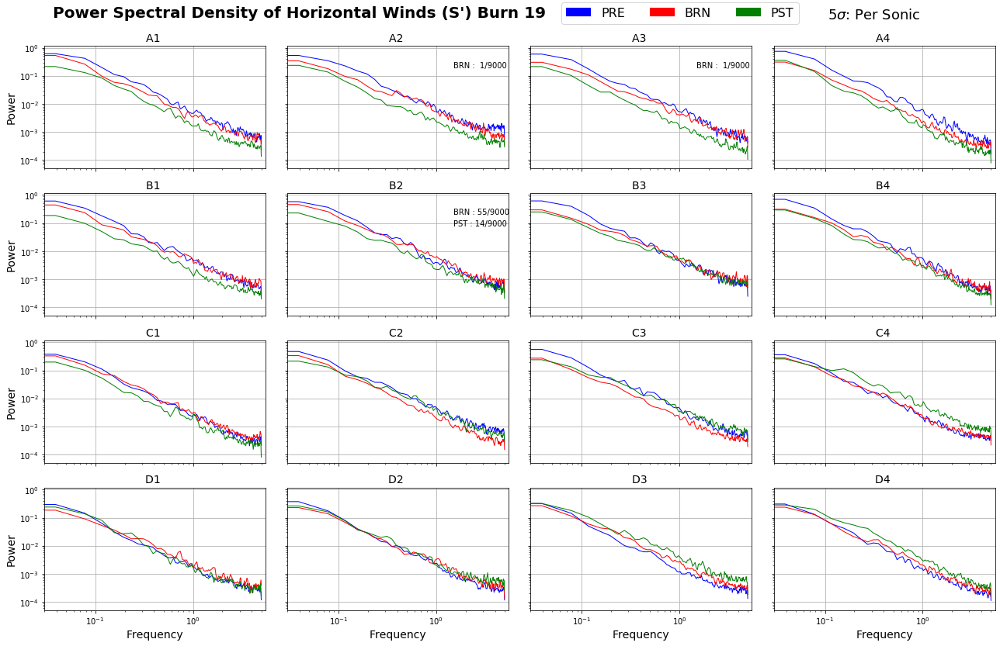

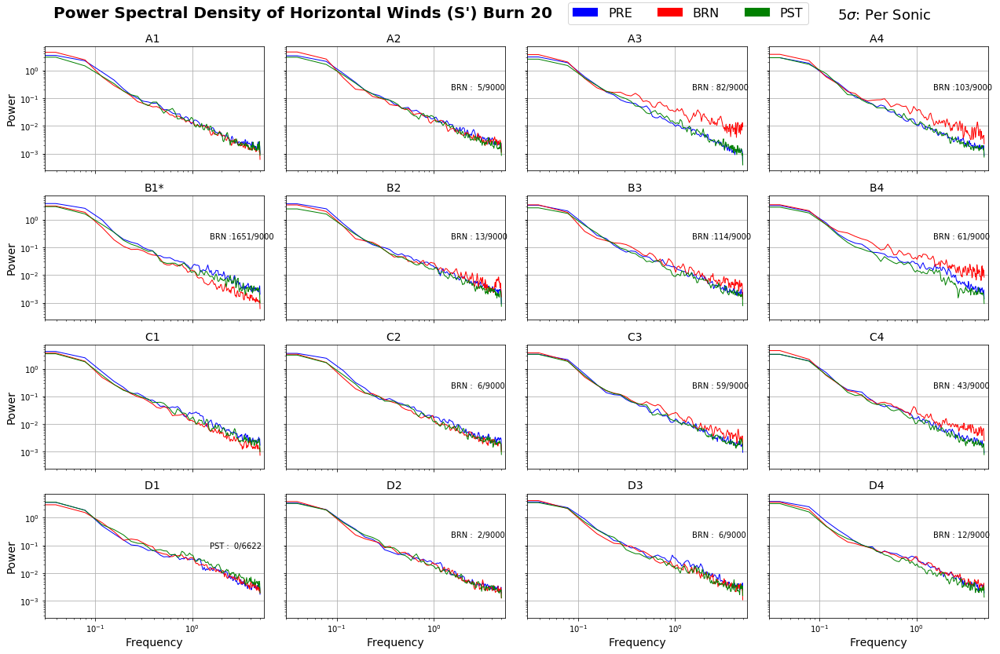

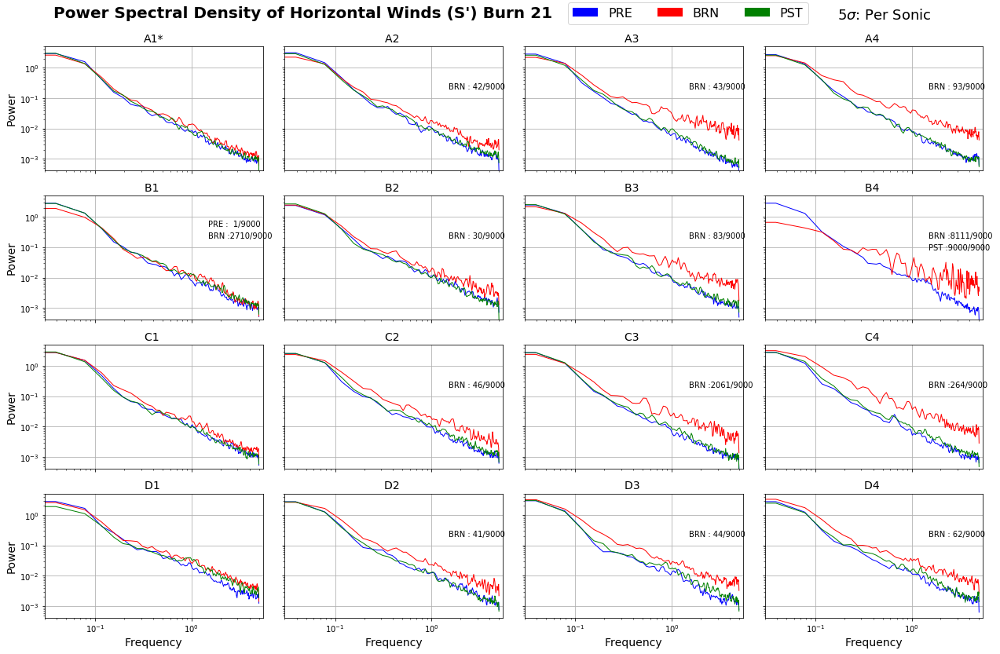

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 246, using nperseg = 246
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 244, using nperseg = 244
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 234, using nperseg = 234
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 217, using nperseg = 217
  .format(nperseg, input_length))


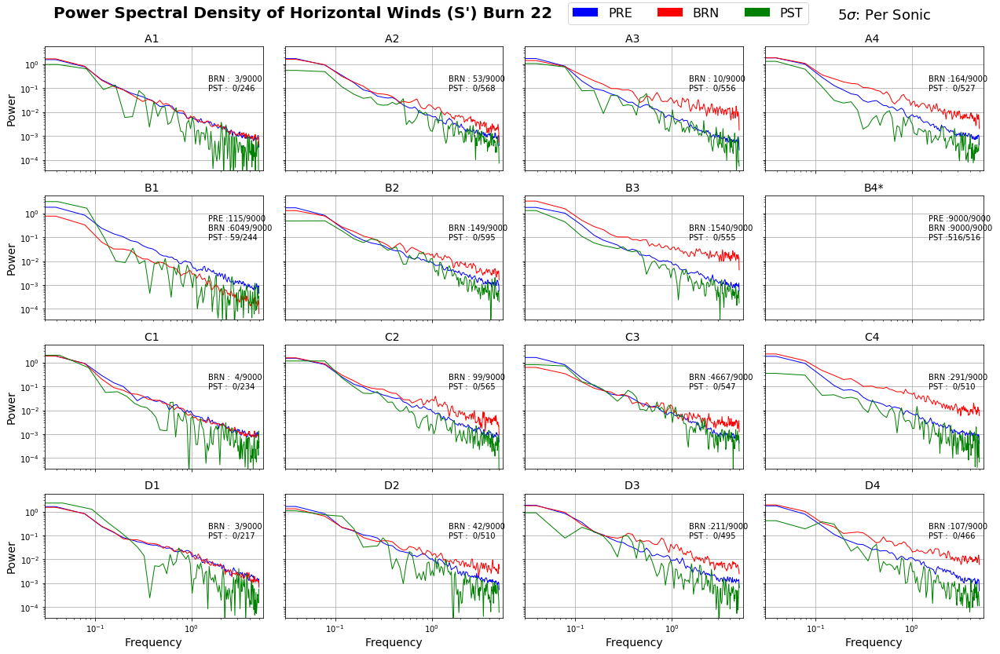

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


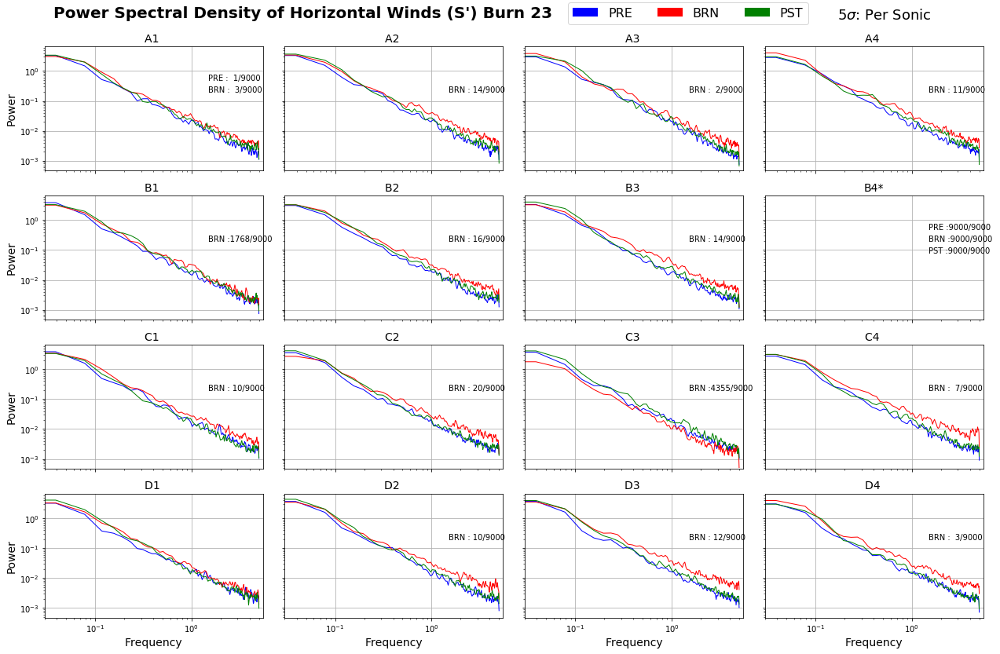

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


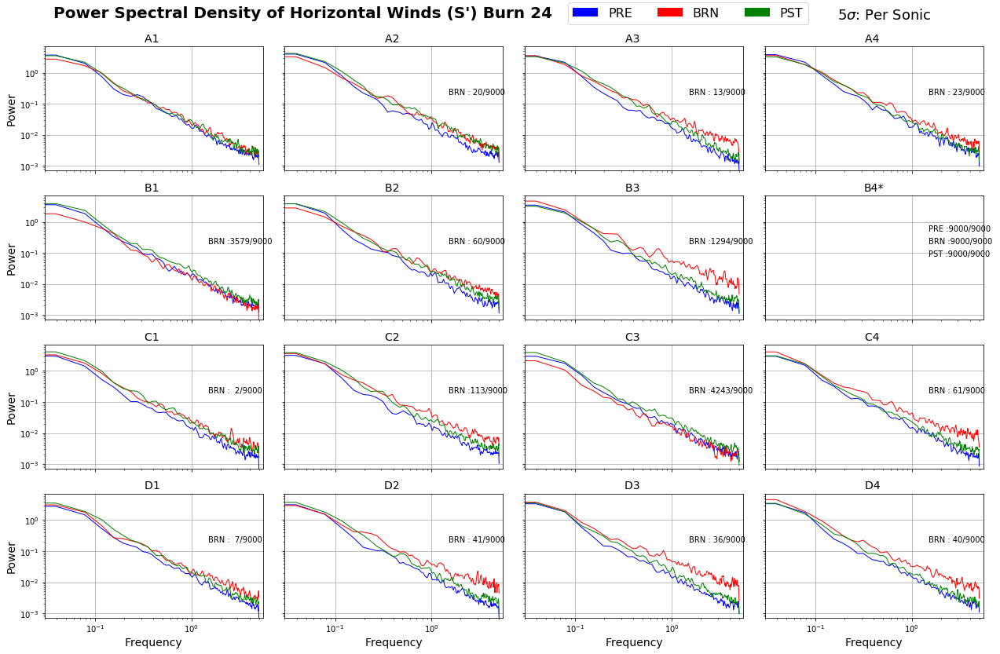

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


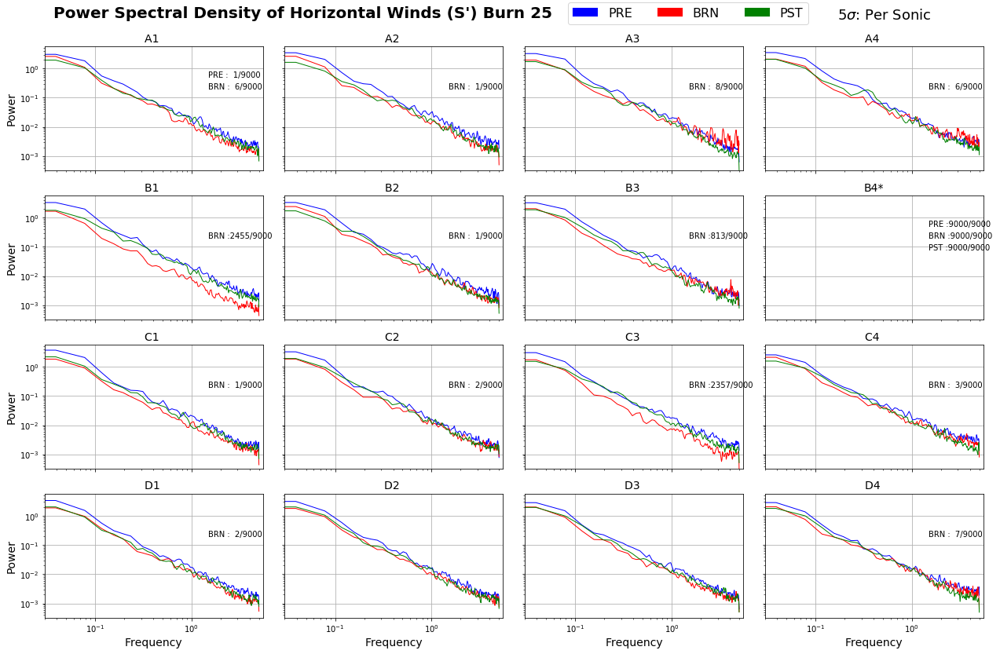

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 72, using nperseg = 72
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 28, using nperseg = 28
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 91, using nperseg = 91
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 78, using nperseg = 78
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\s

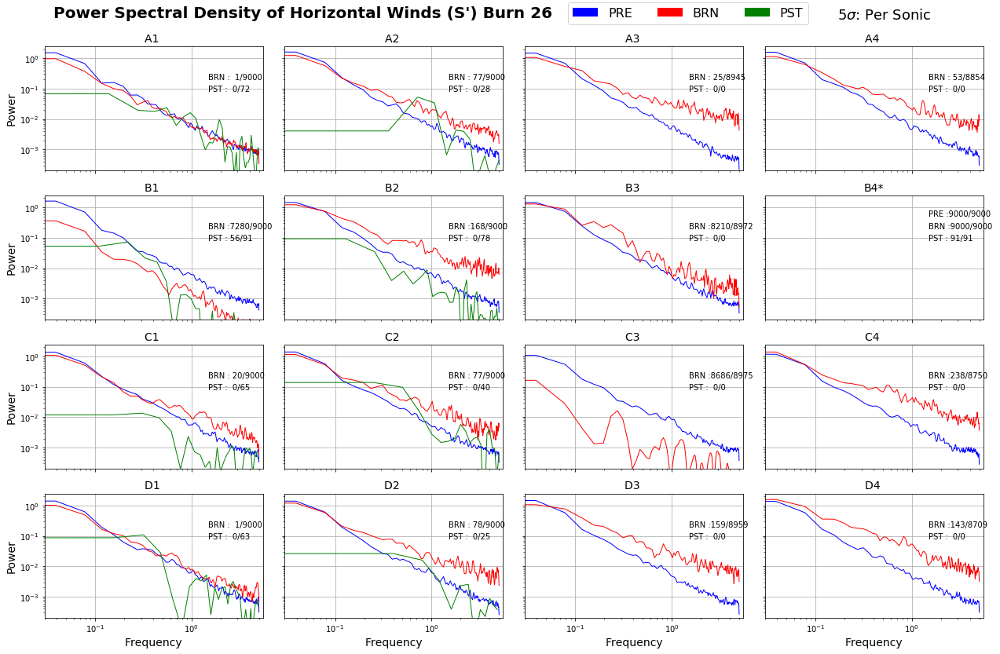

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


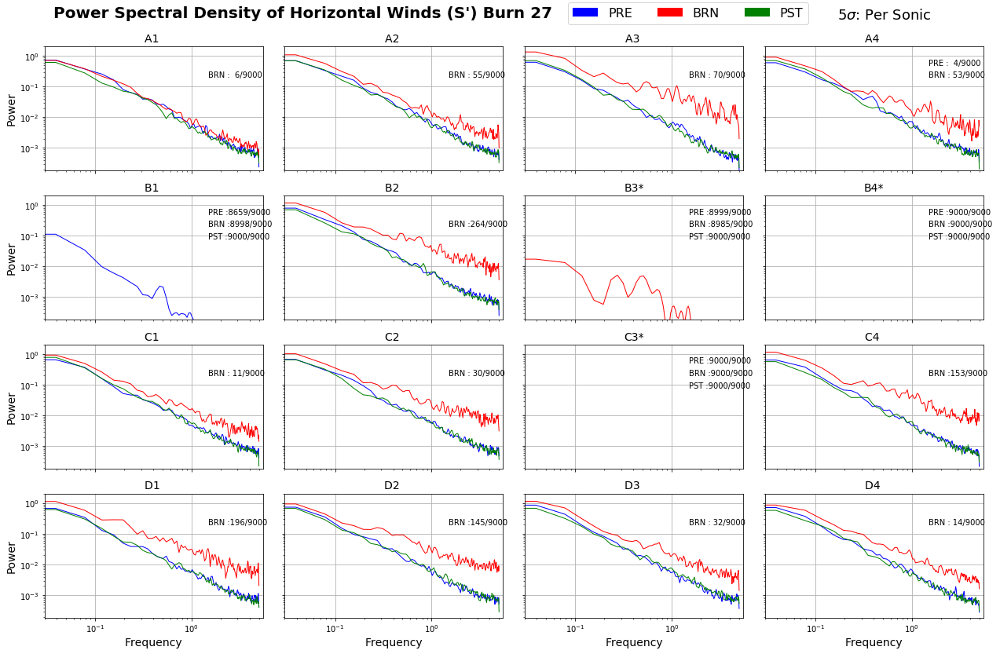

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


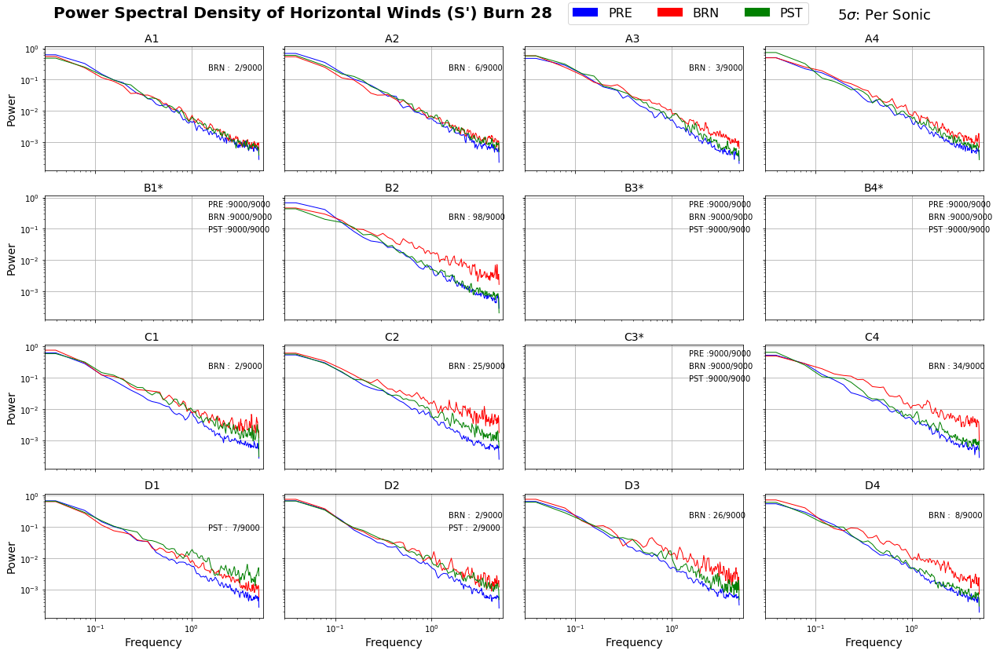

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


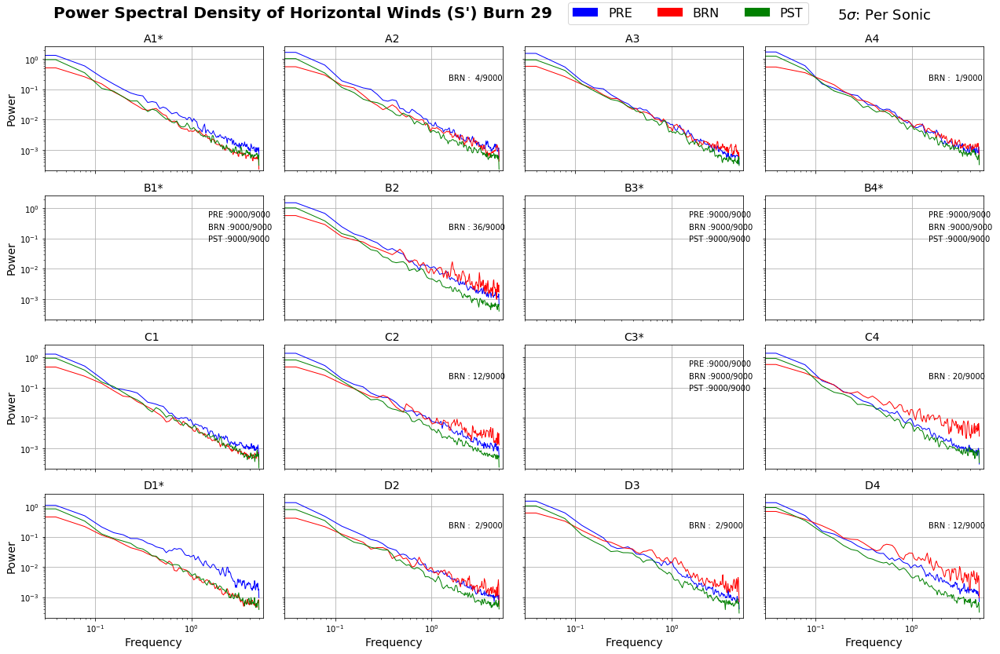

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


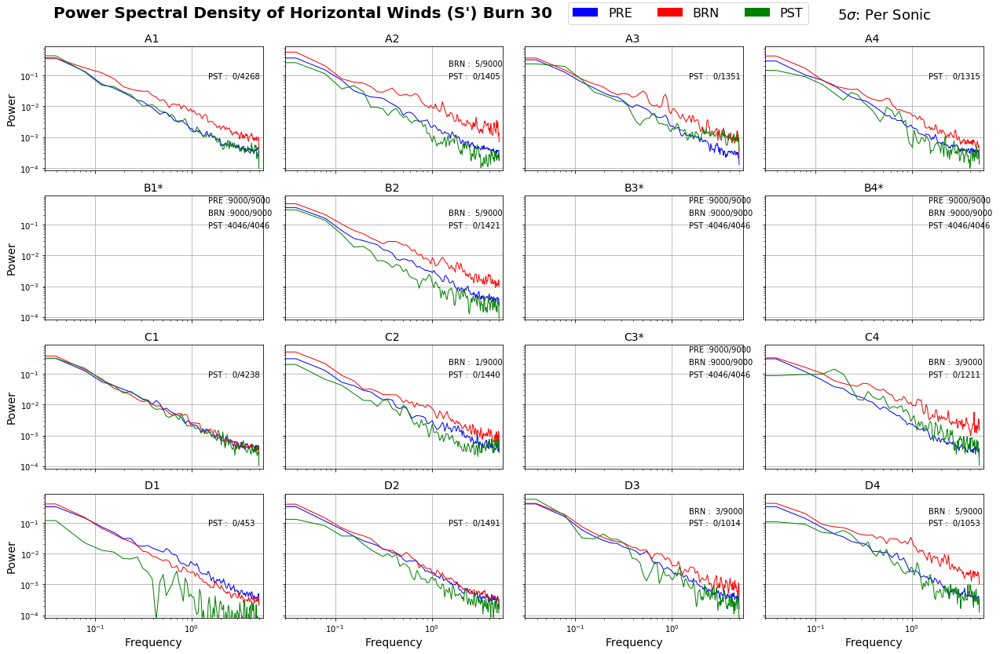

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


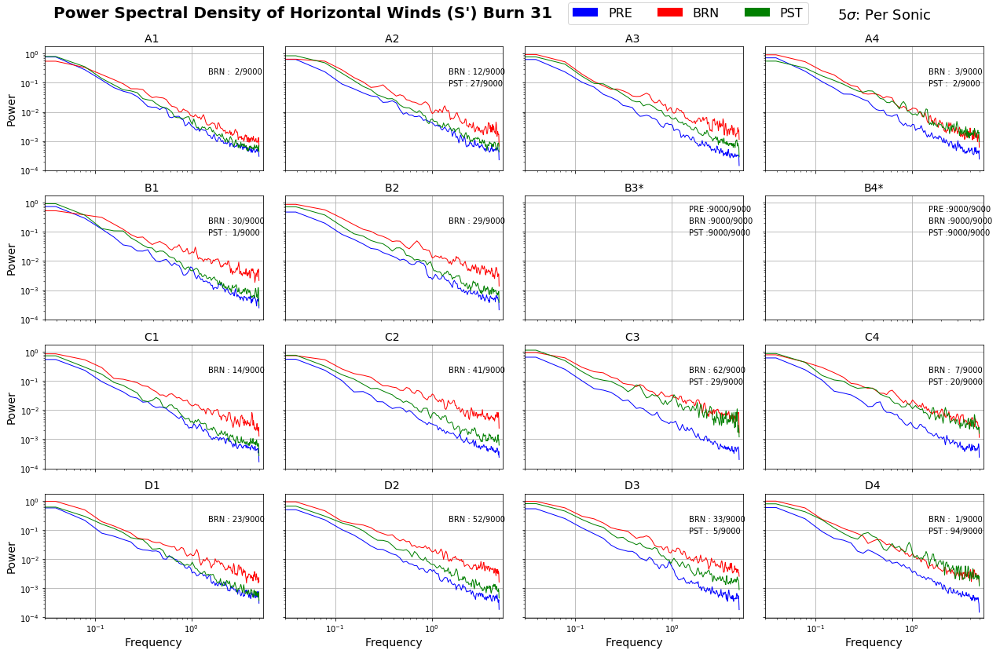

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


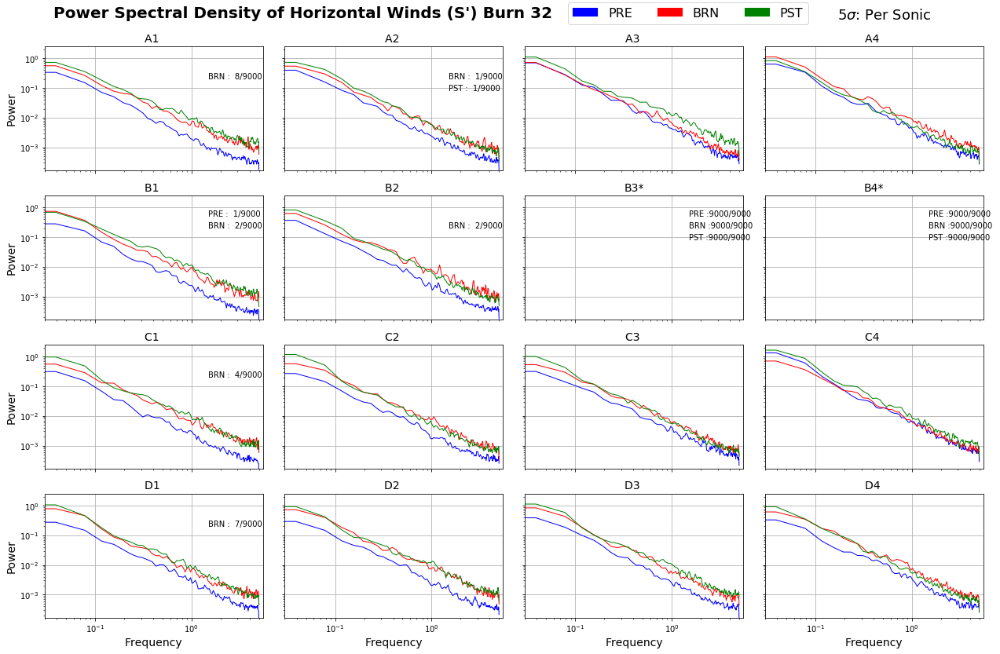

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 200, using nperseg = 200
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 155, using nperseg = 155
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 19, using nperseg = 19
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 188, using nperseg = 188
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1966: UserWarning: nperseg = 256 is greater than input length  = 203, using nperseg = 203
  .format(nperseg, input_length))
C:\ProgramData\Anaconda3\lib\site-packages

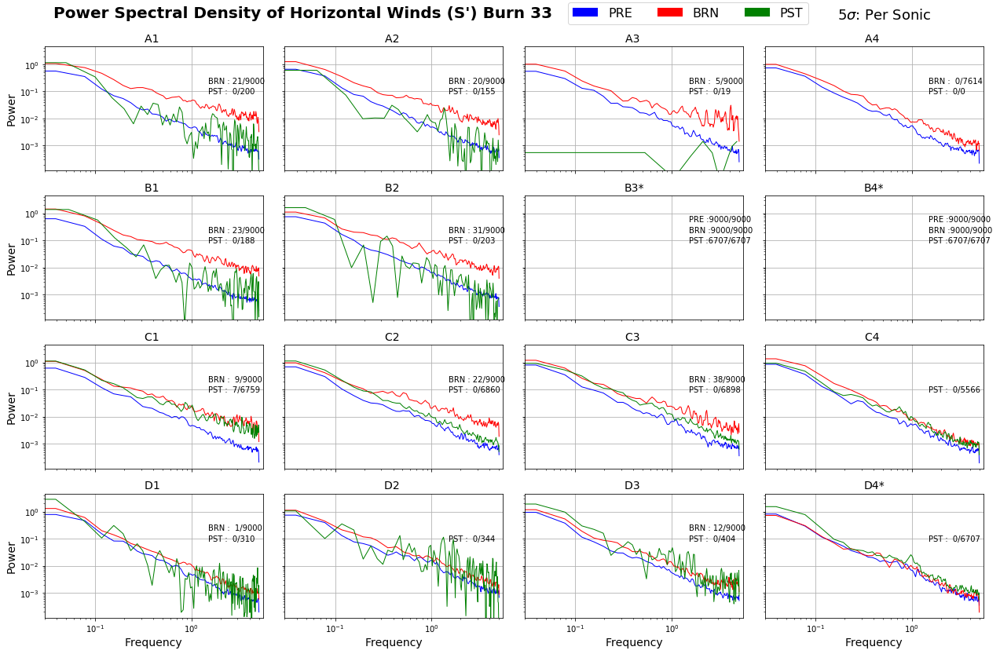

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:39: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: Mean of empty slice


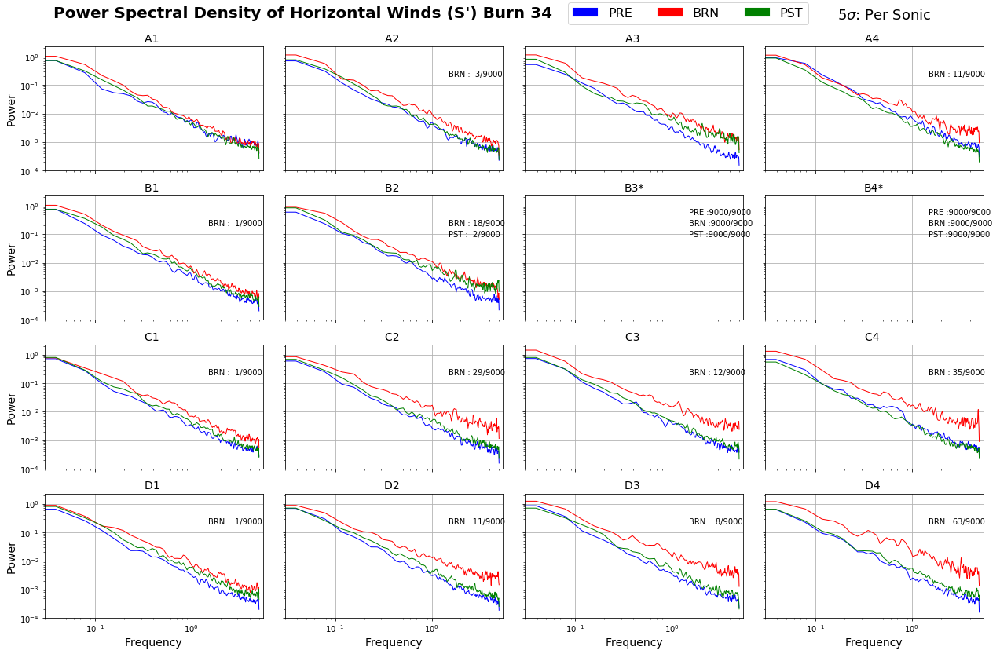

In [7]:
burns = ["01","02","03","04","05","06","07","08","09","11","12","13","18","19","20", \
         "21","22","23","24","25","26","27", "28","29","30","31","32","33","34"]
for i in range(len(burns)):
    #welch_power_spec(burns[i], "S",True)
    welch_power_spec(burns[i], "S",False)

In [46]:
path = "/Users/joeyp/Desktop/10X10_Truss_SERDP_Burns/JS_Cleaned_Data/Full-Timestamp/Burn-" #w10
path_end = "/sonics/"
burn = "03"
p = path+burn+ path_end
files = text_finder(p)

df=file_to_df(p+files[0])
pre_lst, brn_lst, pst_lst = fire_period_split(speed_calculation(df), burn_d[burn][1])

In [62]:
pre_lst, brn_lst, pst_lst = fire_period_split(speed_calculation(df), burn_d[burn][1])
df_burn = pd.DataFrame()
df_burn["var"] = brn_lst

var_lst = brn_lst
b4_nan = []
for i in range(len(var_lst)):
    if str(var_lst[i]).lower() =="nan": 
        b4_nan.append(i)
        
after_nan = []
df_burn = df_burn.interpolate(method='linear', axis=0)
var_lst_1 = list(df_burn["var"])
for i in range(len(var_lst_1)):
    if str(var_lst_1[i]).lower() =="nan": 
        after_nan.append(i)

In [9]:
test_lst = [5.0, "nan", 7.0, 8.0, 9.0]#, np.nan, np.nan, np.nan]

In [11]:
for i in range(len(test_lst)):
    if str(test_lst[i]).lower() =="nan":
        test_lst[i] =(test_lst[i-1]+test_lst[i+1])/2
print(test_lst)
    

[5.0, 6.0, 7.0, 8.0, 9.0]


In [58]:
#file_count=0
#for i in range(16): 
i = 14
df=file_to_df(p+files[i])

pre_lst, brn_lst, pst_lst = fire_period_split(speed_calculation(df), burn_d[burn][1])
print(files[i][:2])
print("PRE", len(pre_lst), pre_lst[:4])
#print("PRE Spec:", welch_spectra(pre_lst))
print("BRN", len(brn_lst), brn_lst[:4])
print("BRN", welch_spectra(brn_lst))
print("PST", len(pst_lst), pst_lst[:4])

D3
PRE 9000 [0.0421791  0.02371083 0.06432019 0.06802133]
BRN 9000 [-0.51637601 -0.58092779 -0.51331213 -0.53596405]
6
BRN (array([0.       , 0.0390625, 0.078125 , 0.1171875, 0.15625  , 0.1953125,
       0.234375 , 0.2734375, 0.3125   , 0.3515625, 0.390625 , 0.4296875,
       0.46875  , 0.5078125, 0.546875 , 0.5859375, 0.625    , 0.6640625,
       0.703125 , 0.7421875, 0.78125  , 0.8203125, 0.859375 , 0.8984375,
       0.9375   , 0.9765625, 1.015625 , 1.0546875, 1.09375  , 1.1328125,
       1.171875 , 1.2109375, 1.25     , 1.2890625, 1.328125 , 1.3671875,
       1.40625  , 1.4453125, 1.484375 , 1.5234375, 1.5625   , 1.6015625,
       1.640625 , 1.6796875, 1.71875  , 1.7578125, 1.796875 , 1.8359375,
       1.875    , 1.9140625, 1.953125 , 1.9921875, 2.03125  , 2.0703125,
       2.109375 , 2.1484375, 2.1875   , 2.2265625, 2.265625 , 2.3046875,
       2.34375  , 2.3828125, 2.421875 , 2.4609375, 2.5      , 2.5390625,
       2.578125 , 2.6171875, 2.65625  , 2.6953125, 2.734375 , 2.7734375,


In [32]:
plt.plot(S_spec_wel_pre,x_pre, color = "r", label = "PRE")
plt.plot(S_spec_wel_brn,x_brn, color = "g", label = "BRN")
plt.plot(S_spec_wel_pst,x_pst, color = "b", label = "PST")
plt.xscale("log")
plt.title("PSD: Power Spectral Density of Horizontal Winds (S')")
plt.xlabel('Frequency')
plt.ylabel('Power')
plt.legend()
plt.yscale("Log")
#plt.xlim(.25,.55*10**2)
#plt.ylim(10**(-5),10**(-1))
plt.show()

NameError: name 'S_spec_wel_pre' is not defined

In [54]:
#np.mean(W_list_pre)

W_list_pre = np.array(df_a1["W"][22289-9000:22289])
W_list_brn = np.array(df_a1["W"][22289:22289+9000])
W_list_pst = np.array(df_a1["W"][22289+9000:22289+18000])
W_mean = np.mean(W_list_pre)

W_list_pre -= W_mean
W_list_brn -= W_mean
W_list_pst -= W_mean

#w_spec_wel_pre = sc.signal.spectrogram(W_list_pre)
w_spec_wel_pre, x_pre = signal.welch(W_list_pre, 100)
w_spec_wel_brn, x_brn = signal.welch(W_list_brn, 100)
w_spec_wel_pst, x_pst = signal.welch(W_list_pst, 100)

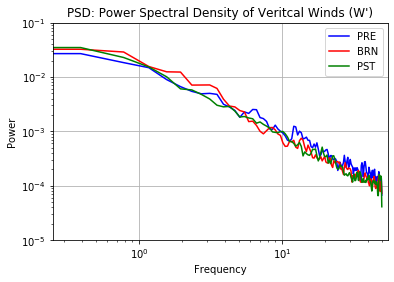

In [92]:
plt.plot(w_spec_wel_pre,x_pre, color = "b", label = "PRE")
plt.plot(w_spec_wel_brn,x_brn, color = "r", label = "BRN")
plt.plot(w_spec_wel_pst,x_pst, color = "g", label = "PST")
plt.xscale("log")
plt.title("PSD: Power Spectral Density of Veritcal Winds (W')")
plt.xlabel('Frequency')
plt.ylabel('Power')
plt.legend()
plt.yscale("Log")
plt.xlim(.25,.55*10**2)
plt.ylim(10**(-5),10**(-1))
plt.grid()
plt.show()

In [112]:
import numpy as np
import scipy.fftpack as fftpack
def power_spectra(data):
    #data might need to have the mean subtracted from it

    #data = W_list_pre
    fft_data = fftpack.fft(data, axis=-1) #you can play with this part
    powerspec = np.multiply(fft_data, np.conj(fft_data))
    #powerspec
    ##Fun times, let me know if you want info on normalization and noise subtraction
    #powerspec = sc.signal.resample(powerspec, 4500)#, t=None, axis=0, window=None)[source]¶
    
    return powerspec

C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


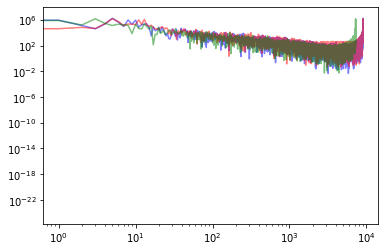

In [116]:
plt.plot(power_spectra(pre_lst), label = "PRE", alpha = .5, c = "b")
plt.plot(power_spectra(brn_lst), label = "BRN", alpha = .5, c = "r")
plt.plot(power_spectra(pst_lst), label = "PST", alpha = .5, c = "g")
plt.yscale("Log")
plt.xscale("Log")
#plt.ylim(10**-6,10**6)
#plt.xlim(.1, 10**4)

In [63]:
w_spec_lst = sc.signal.spectrogram(W_list_pre,10)
len(w_spec_lst[0])

129

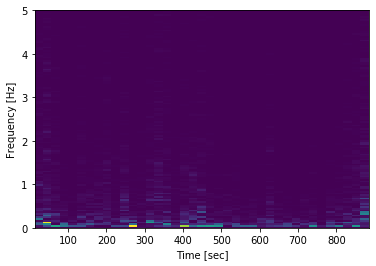

In [43]:
f, t, Sxx = signal.spectrogram(W_list_pre, 10)
>>> plt.pcolormesh(t, f, Sxx)
>>> plt.ylabel('Frequency [Hz]')
>>> plt.xlabel('Time [sec]')
>>> plt.show()

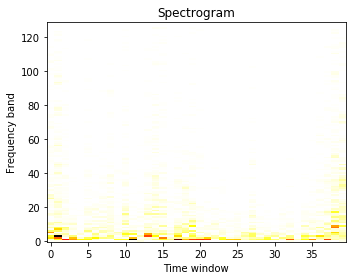

In [56]:
freqs, times, spectrogram = signal.spectrogram(W_list_pre, 10)

plt.figure(figsize=(5, 4))
plt.imshow(spectrogram, aspect='auto', cmap='hot_r', origin='lower')
plt.title('Spectrogram')
plt.ylabel('Frequency band')
plt.xlabel('Time window')
plt.tight_layout()